In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import pickle
import statistics
from sklearn.metrics import classification_report, accuracy_score, f1_score, precision_score, recall_score, confusion_matrix

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms
from torch.optim.lr_scheduler import StepLR

import significantdigits as sd
from significantdigits import Error, Method
import itertools
import nibabel as nib
import re
import random

## Initial Weight Distribution
* Default conv setup is sparse

In [ ]:
class Net_weights(nn.Module):
    def __init__(self, init_mode=None):
        super(Net_weights, self).__init__()
        self.init_mode = init_mode

        self.conv1 = nn.Conv2d(1, 32, 3, 1, bias=True)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, bias=True)
        self.dropout1 = nn.Dropout(0.25)
        self.dropout2 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(9216, 128)
        self.fc2 = nn.Linear(128, 10)

        if self.init_mode:
            self.initialize_weights()

    def initialize_weights(self):
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.Linear)):
                if self.init_mode == 'uniform':
                    nn.init.normal_(m.weight)
                elif self.init_mode == 'normal':
                    nn.init.normal_(m.weight)
                elif self.init_mode == 'ones':
                    nn.init.ones_(m.weight)
                elif self.init_mode == 'zeros':
                    nn.init.zeros_(m.weight)
                elif self.init_mode == 'identity':
                    if isinstance(m, nn.Linear):
                        nn.init.eye_(m.weight)
                elif self.init_mode == 'eye':
                    if isinstance(m, nn.Linear):
                        nn.init.eye_(m.weight)
                elif self.init_mode == 'dirac':
                    if isinstance(m, nn.Conv2d):
                        nn.init.dirac_(m.weight)
                elif self.init_mode == 'xavier_uniform':
                    nn.init.xavier_uniform_(m.weight)
                elif self.init_mode == 'xavier_normal':
                    nn.init.xavier_normal_(m.weight)
                elif self.init_mode == 'kaiming_uniform':
                    nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
                elif self.init_mode == 'kaiming_normal':
                    nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
                elif self.init_mode == 'orthogonal':
                    nn.init.orthogonal_(m.weight)
                elif self.init_mode == 'sparse':
                    if isinstance(m, nn.Linear):
                        nn.init.sparse_(m.weight, sparsity=0.1)
                
                if m.bias is not None:
                    nn.init.zeros_(m.bias)

    def forward(self, x):
        x = self.conv1(x)
        x = F.relu(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = F.max_pool2d(x, 2)
        x = self.dropout1(x)
        x = torch.flatten(x, 1)
        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout2(x)
        x = self.fc2(x)
        output = F.log_softmax(x, dim=1)
        return output
    

### Conv

In [ ]:
weight_seeds = []
for i in range(10):
    torch.manual_seed(i)
    random.seed(i)
    np.random.seed(i)

    model = Net_weights(init_mode=None)
    weight_seeds.append( model.conv1.weight.squeeze().detach().numpy() )

In [ ]:
weight_init = []
for i in ['uniform', 'normal', 'ones', 'zeros', 'dirac', 'xavier_uniform', 'xavier_normal', 'kaiming_uniform', 'kaiming_normal', 'orthogonal', 'sparse']:
    torch.manual_seed(0)
    random.seed(0)
    np.random.seed(0)

    model = Net_weights(init_mode=i)
    weight_init.append( model.conv1.weight.squeeze().detach().numpy() )

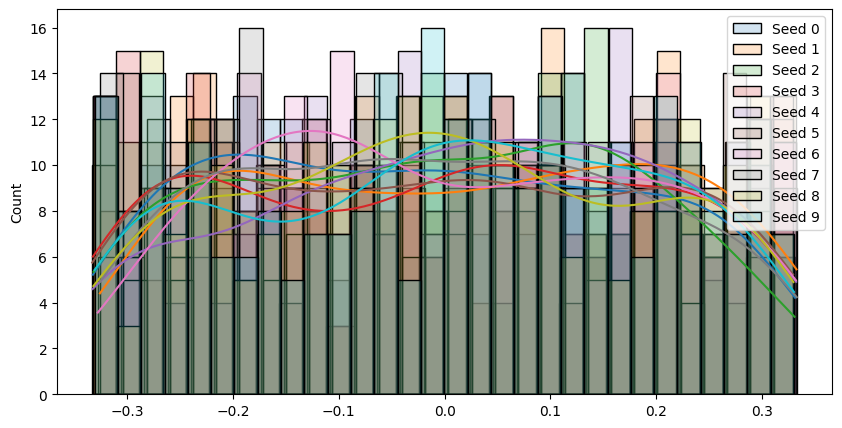

In [16]:
plt.figure(figsize=(10,5))

for i in range(10):
    # plt.hist(weight_seeds[i].flatten(), bins=30, alpha=0.2, label=f'Seed {i}');
    sns.histplot(weight_seeds[i].flatten(), bins=30, kde=True, alpha=0.2, label=f'Seed {i}', );

plt.legend();

''

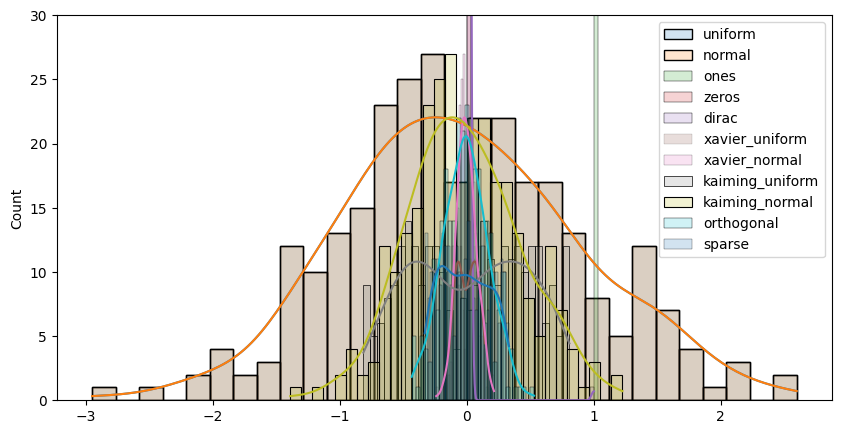

In [21]:
plt.figure(figsize=(10,5))
# LINEAR: 'identity' 'eye'
# CONV: 'dirac
for num, i in enumerate(['uniform', 'normal', 'ones', 'zeros', 'dirac', 'xavier_uniform', 'xavier_normal', 'kaiming_uniform', 'kaiming_normal', 'orthogonal', 'sparse']):
    sns.histplot(weight_init[num].flatten(), bins=30, kde=True, alpha=0.2, label=f'{i}')

plt.ylim(0,30)
plt.legend()
# plt.figure();
;

### Linear

In [25]:
weight_seeds = []
for i in range(10):
    torch.manual_seed(i)
    random.seed(i)
    np.random.seed(i)

    model = Net_weights(init_mode=None)
    weight_seeds.append( model.fc1.weight.squeeze().detach().numpy() )

weight_init = []
for i in ['uniform', 'normal', 'ones', 'zeros', 'identity', 'eye', 'xavier_uniform', 'xavier_normal', 'kaiming_uniform', 'kaiming_normal', 'orthogonal', 'sparse']:
    torch.manual_seed(0)
    random.seed(0)
    np.random.seed(0)

    model = Net_weights(init_mode=i)
    weight_init.append( model.fc1.weight.squeeze().detach().numpy() )

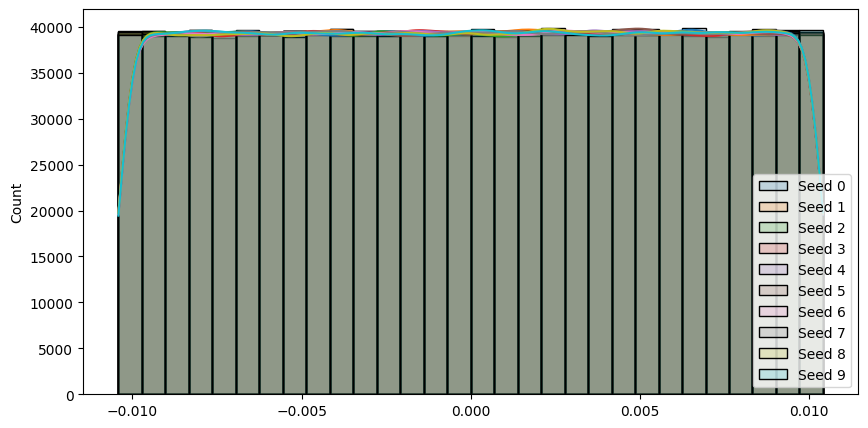

In [24]:
plt.figure(figsize=(10,5))

for i in range(10):
    # plt.hist(weight_seeds[i].flatten(), bins=30, alpha=0.2, label=f'Seed {i}');
    sns.histplot(weight_seeds[i].flatten(), bins=30, kde=True, alpha=0.2, label=f'Seed {i}', );

plt.legend();

''

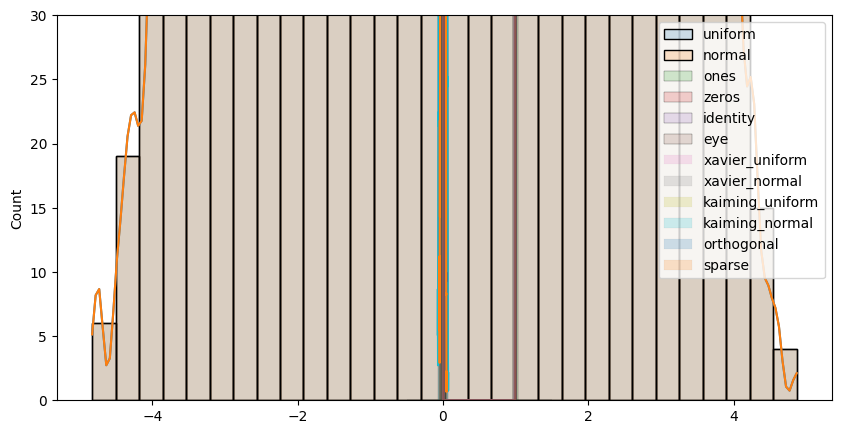

In [31]:
plt.figure(figsize=(10,5))
# LINEAR: 'identity' 'eye'
# CONV: 'dirac
for num, i in enumerate(['uniform', 'normal', 'ones', 'zeros', 'identity', 'eye', 'xavier_uniform', 'xavier_normal', 'kaiming_uniform', 'kaiming_normal', 'orthogonal', 'sparse']):
    sns.histplot(weight_init[num].flatten(), bins=30, kde=True, alpha=0.2, label=f'{i}')

plt.ylim(0,30)
plt.legend()
# plt.figure();
;

## TO DO
* Explore layer wise relevance scores?

In [2]:
def process_log(dir, filename, iter=6, hessian=False, filetype='out'):

    train_loss = []
    val_loss = []
    test_loss = []
    train_accuracy = []
    val_accuracy = []
    test_accuracy = []
    if hessian:
        hessian_1 = []
        hessian_2 = []

    for i in range(1,iter):
        # if i == 3 or i==4: continue

        tmp_train_loss = []
        tmp_val_loss = []
        tmp_test_loss = []
        if hessian:
            tmp_hessian1 = []
            tmp_hessian2 = []
        tmp_train_acc = []
        tmp_val_acc = []
        tmp_test_acc = []

        # file = open(f"{DIR}/ieee_train_{i}.out", 'r')
        file = open(f"{dir}/{filename}_{i}.{filetype}", 'r')

        for line in file: 
            # if filename == 'fuzzy_mnist_train_sr':
                # if "Train Epoch: 13" in line: break

            if "Train Epoch" in line:
                # print(line.split('\t'))
                line = line.split('\t')
                # print(line)
                tmp_train_loss.append( float(line[2].split('Loss: ')[-1].strip()) )
                tmp_train_acc.append( float(line[1].split('Accuracy: ')[-1].strip()) )
                if hessian:
                    tmp_hessian1.append( float(line[-1].split('Eigenvalues [')[-1].split(',')[0].strip()) )
                    tmp_hessian2.append( float(line[-1].split('Eigenvalues [')[-1].split(',')[-1].split(']')[0].strip()) )
            elif "Validation" in line:
                # line = line.split('\t')
                tmp_val_loss.append( float(line.split('loss: ')[-1].split(',')[0].strip()) )
                tmp_val_acc.append( float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[0].strip()) / float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[1].strip()))
            elif "Test set" in line:
                # line = line.split('\t')
                tmp_test_loss.append( float(line.split('loss: ')[-1].split(',')[0].strip()) )
                tmp_test_acc.append( float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[0].strip()) / float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[1].strip()))

        train_loss.append(tmp_train_loss)
        val_loss.append(tmp_val_loss)
        test_loss.append(tmp_test_loss)

        train_accuracy.append(tmp_train_acc)
        val_accuracy.append(tmp_val_acc)
        test_accuracy.append(tmp_test_acc)

        if hessian:
            hessian_1.append(tmp_hessian1)
            hessian_2.append(tmp_hessian2)

    train_loss = np.stack(train_loss)
    val_loss = np.stack(val_loss)
    test_loss = np.stack(test_loss)
    train_accuracy = np.stack(train_accuracy)
    val_accuracy = np.stack(val_accuracy)
    test_accuracy = np.stack(test_accuracy)
    if hessian:
        hessian_1 = np.stack(hessian_1)
        hessian_2 = np.stack(hessian_2)

        return train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy, hessian_1, hessian_2
    else:
        return train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy 
    

def process_log_ieee(dir, filename, hessian=False, filetype='out'):
    result = {
        "train_loss": [],
        "val_loss": [],
        "test_loss": [],
        "train_accuracy": [],
        "val_accuracy": [],
        "test_accuracy": []
    }
    if hessian:
        result["hessian_1"] = []
        result["hessian_2"] = []

    file = open(f"{dir}/{filename}.{filetype}", 'r')

    for line in file:
        if "Train Epoch" in line:
            line = line.split('\t')
            result["train_loss"].append(float(line[2].split('Loss: ')[-1].strip()))
            result["train_accuracy"].append(float(line[1].split('Accuracy: ')[-1].strip()))
            if hessian:
                result["hessian_1"].append(float(line[-1].split('Eigenvalues [')[-1].split(',')[0].strip()))
                result["hessian_2"].append(float(line[-1].split('Eigenvalues [')[-1].split(',')[-1].split(']')[0].strip()))
        elif "Validation" in line:
            result["val_loss"].append(float(line.split('loss: ')[-1].split(',')[0].strip()))
            acc_parts = line.split('Accuracy: ')[-1].split(' (')[0].split('/')
            result["val_accuracy"].append(float(acc_parts[0].strip()) / float(acc_parts[1].strip()))
        elif "Test set" in line:
            result["test_loss"].append(float(line.split('loss: ')[-1].split(',')[0].strip()))
            acc_parts = line.split('Accuracy: ')[-1].split(' (')[0].split('/')
            result["test_accuracy"].append(float(acc_parts[0].strip()) / float(acc_parts[1].strip()))

    # Convert to np.array
    for key in result:
        result[key] = np.array(result[key])
    return result


In [4]:
# IEEE
# ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy, ieee_hessian_1, ieee_hessian_2 = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_train', iter=6, hessian=True)
ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_mnist_train', iter=11, hessian=False, filetype='log')

## Optimizers

In [4]:
base_dir = '/home/inesgp/cnn_training/optim_losses'
initializations = ['ieee', 'Adagrad', 'Adam', 'SGD', 'LBFGS', 'RMSprop']

def results_to_df(results, metric_name):
    records = []
    for init_name, metrics in results.items():
        values = metrics[metric_name]
        if isinstance(values, (list, np.ndarray)):
            for step, val in enumerate(values):
                if init_name == 'ieee': init_name = 'Adadelta'
                records.append({'step': step, 'value': val, 'initialization': init_name})
        else:
            # for test set single values
            records.append({'step': 0, 'value': values, 'initialization': init_name})
    return pd.DataFrame(records)


results = {}
for init in initializations:
    filename = 'ieee_mnist_train_1' if init == 'ieee' else f'optim_{init}'
    dir_path = '/home/inesgp/cnn_training/slurm' if init == 'ieee' else base_dir
    results[init] = process_log_ieee(dir=dir_path, filename=filename, hessian=False, filetype='log')


### Individual Optimizers

In [11]:
## Training Loss
df_train_loss = results_to_df(results, 'train_loss')
fig = px.line(df_train_loss, x='step', y='value', color='initialization',
              title='Training Loss',
              labels={'step': 'Model Steps', 'value': 'Training Loss'})
fig.update_layout(yaxis_range=[0, 100])
fig.show()

## Training Accuracy
df_train_acc = results_to_df(results, 'train_accuracy')
fig = px.line(df_train_acc, x='step', y='value', color='initialization',
              title='Training Accuracy',
              labels={'step': 'Model Steps', 'value': 'Training Accuracy'})
fig.show()


## Validation Loss
df_val_loss = results_to_df(results, 'val_loss')
fig = px.line(df_val_loss, x='step', y='value', color='initialization',
              title='Validation Loss',
              labels={'step': 'Model Steps', 'value': 'Validation Loss'})
# fig.update_layout(yaxis_range=[0, 100])
fig.show()


## Validation Accuracy
df_val_acc = results_to_df(results, 'val_accuracy')
fig = px.line(df_val_acc, x='step', y='value', color='initialization',
              title='Validation Accuracy: All weight initializations',
              labels={'step': 'Model Epochs', 'value': 'Validation Accuracy'})
fig.show()


## Test Loss & Accuracy
df_test_loss = results_to_df(results, 'test_loss')
fig = px.scatter(df_test_loss, x='initialization', y='value',
                 title='Test Loss: All initializations', labels={'value': 'Test Loss'})
fig.show()

df_test_acc = results_to_df(results, 'test_accuracy')
fig = px.scatter(df_test_acc, x='initialization', y='value',
                 title='Test Accuracy: All initializations', labels={'value': 'Test Accuracy'})
fig.show()


### Standard Deviation -- add in LBFGS when it completes

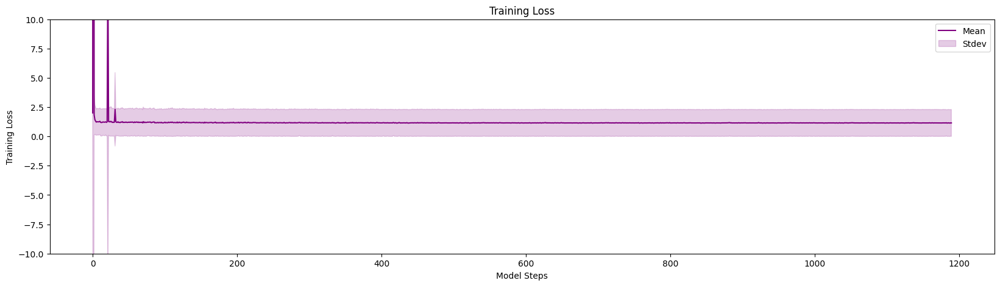

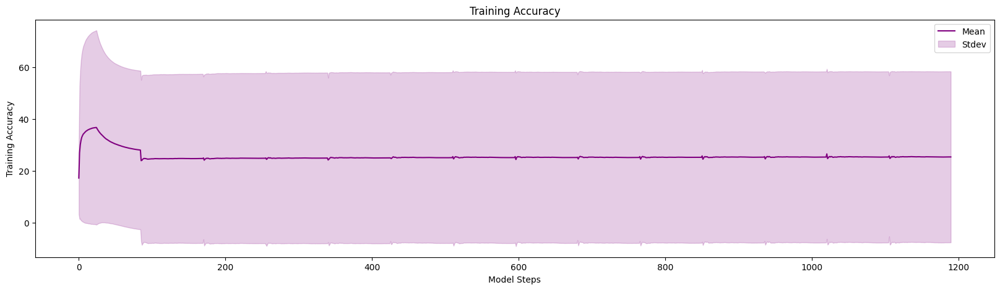

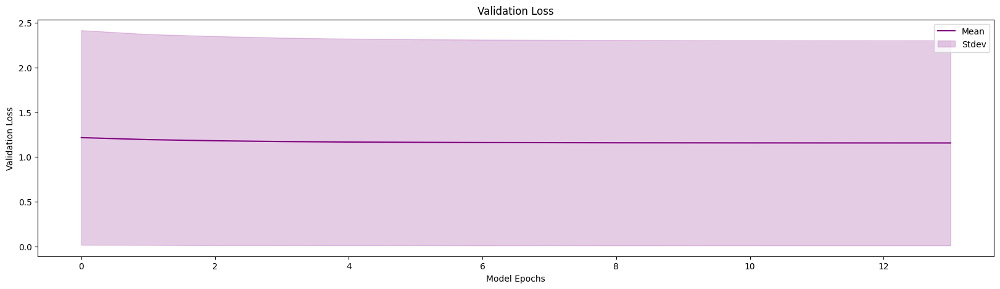

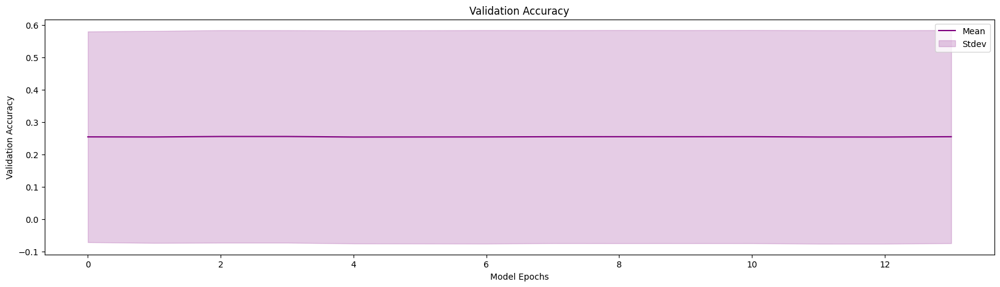

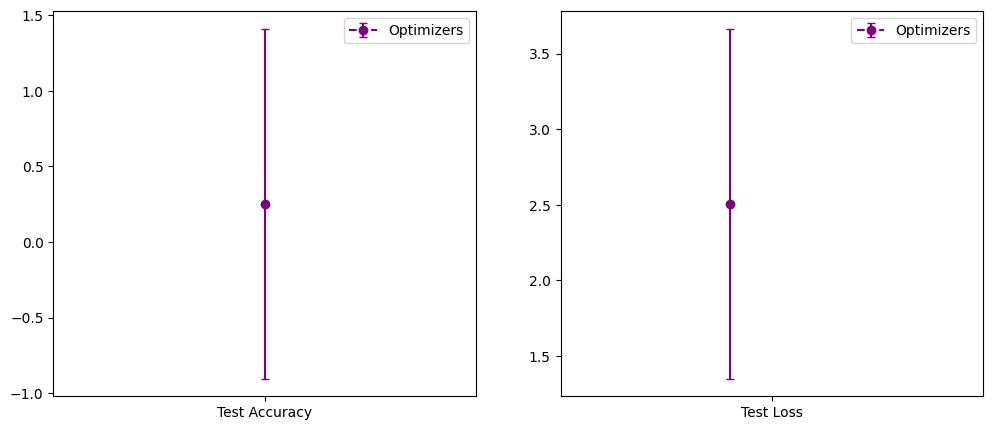

In [7]:
# Training Loss
plt.figure(figsize=(20, 5))
mean = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() ])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() ])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
plt.ylim(-10,10)
plt.legend(), plt.title('Training Loss');

# Training Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['train_accuracy'] for init, data in results.items() ]).mean(axis=0)
stdev = np.array([data['train_accuracy'] for init, data in results.items() ]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Training Accuracy');

# Validation Loss
plt.figure(figsize=(20, 5))
mean = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Loss')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Loss');

# Validation Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['val_accuracy'] for init, data in results.items() ]).mean(axis=0)
stdev = np.array([data['val_accuracy'] for init, data in results.items() ]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Accuracy');

# Test Loss
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.nan_to_num(np.array([data['test_accuracy'] for init, data in results.items() ])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "purple", color = "purple", label='Optimizers')
axes[0].set_xticks([1], ['Test Accuracy']), axes[0].legend()
axes[0].set_xlim(0.95,1.05)
axes[1].errorbar([0.99], np.nan_to_num(np.array([data['test_loss'] for init, data in results.items() ])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "purple", color = "purple", label='Optimizers')
axes[1].set_xticks([1], ['Test Loss']), axes[1].legend();
axes[1].set_xlim(0.95,1.05);


### Comparison to MCA and Random Seeds

In [12]:
# IEEE
ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_mnist_train', iter=11, hessian=False, filetype='log')# Fuzzy SR

# Fuzzy SR
sr_train_loss, sr_val_loss, sr_test_loss, sr_train_accuracy, sr_val_accuracy, sr_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False, filetype='log')
# Random Seed
random_train_loss, random_val_loss, random_test_loss, random_train_accuracy, random_val_accuracy, random_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_v2_mnist_train', hessian=False, iter=11, filetype='log')


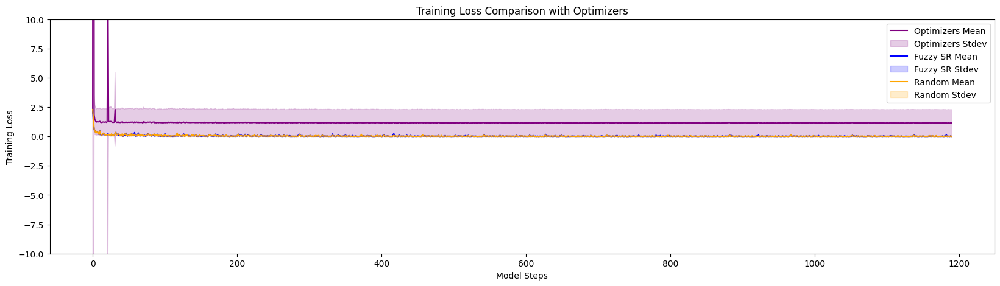

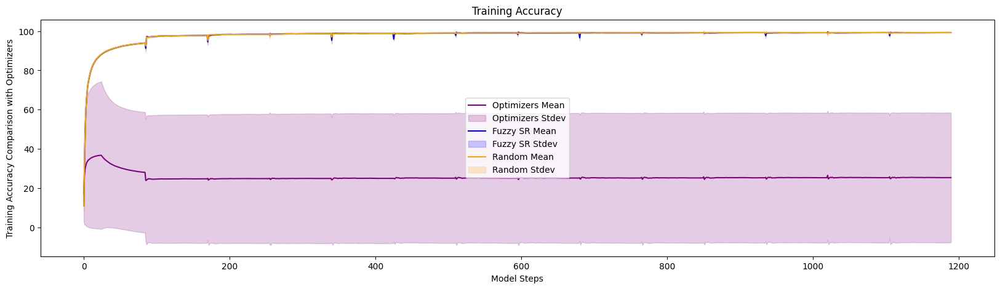

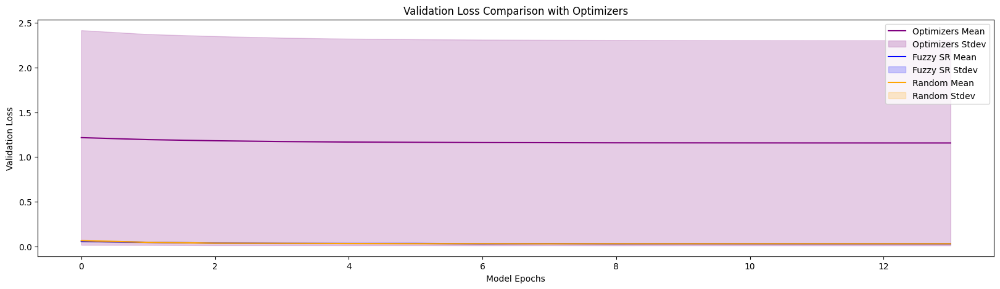

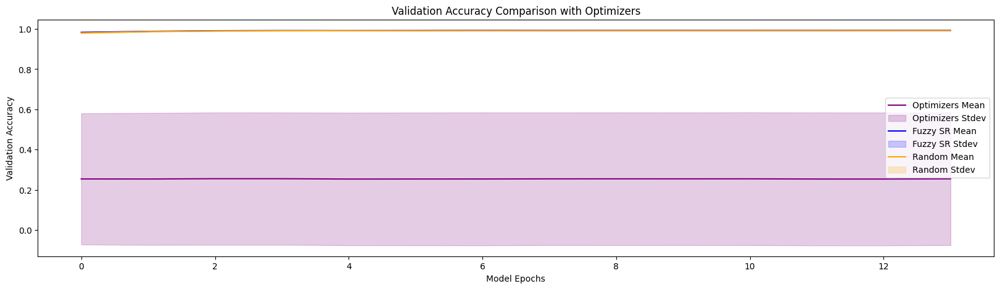

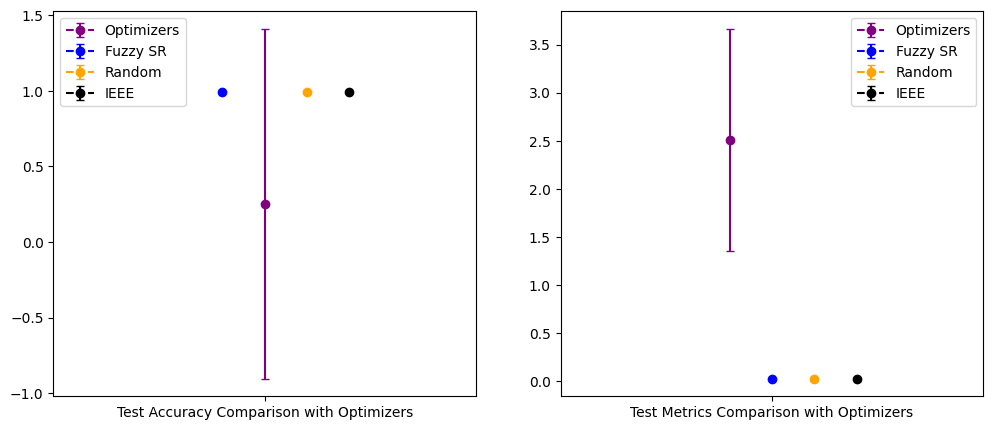

In [13]:
## Training Loss
plt.figure(figsize=(20, 5))
# Optimizers
mean = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() ])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() ])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Optimizers Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Optimizers Stdev')
# Fuzzy SR
mean = sr_train_loss.mean(axis=0)
stdev = sr_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
#Random Seed
mean = random_train_loss.mean(axis=0)
stdev = random_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')

plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
plt.ylim(-10,10)
plt.legend(), plt.title('Training Loss Comparison with Optimizers');

## Training Accuracy
plt.figure(figsize=(20, 5))
# Optimizers
mean = np.array([data['train_accuracy'] for init, data in results.items() ]).mean(axis=0)
stdev = np.array([data['train_accuracy'] for init, data in results.items() ]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Optimizers Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Optimizers Stdev')
#Fuzzy SR
mean = sr_train_accuracy.mean(axis=0)
stdev = sr_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
#Random Seed
mean = random_train_accuracy.mean(axis=0)
stdev = random_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')

plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy Comparison with Optimizers')
# plt.ylim(-10,10)
plt.legend(), plt.title('Training Accuracy');

## Validation Loss
plt.figure(figsize=(20, 5))
# Optimizers
mean = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Optimizers Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Optimizers Stdev')
#Fuzzy SR
mean = sr_val_loss.mean(axis=0)
stdev = sr_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
#Random
mean = random_val_loss.mean(axis=0)
stdev = random_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')

plt.xlabel('Model Epochs'), plt.ylabel('Validation Loss')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Loss Comparison with Optimizers');

## Validation Accuracy
plt.figure(figsize=(20, 5))
# Optimizers
mean = np.array([data['val_accuracy'] for init, data in results.items() ]).mean(axis=0)
stdev = np.array([data['val_accuracy'] for init, data in results.items() ]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Optimizers Mean', color='purple', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='purple', alpha=0.2, label='Optimizers Stdev')
# Fuzzy SR
mean = sr_val_accuracy.mean(axis=0)
stdev = sr_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# Random
mean = random_val_accuracy.mean(axis=0)
stdev = random_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')

plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Accuracy Comparison with Optimizers');

## Test Loss & Accuracy
fig, axes = plt.subplots(1,2, figsize=(12,5))
# Optimizers
axes[0].errorbar([1], np.nan_to_num(np.array([data['test_accuracy'] for init, data in results.items() ])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "purple", color = "purple", label='Optimizers')
# Fuzzy SR
axes[0].errorbar([0.99], np.mean(sr_test_accuracy), yerr=np.std(sr_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Fuzzy SR')
# Random
axes[0].errorbar([1.01], np.mean(random_test_accuracy), yerr=np.std(random_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Random')
# IEEE
axes[0].errorbar([1.02], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')

axes[0].set_xticks([1], ['Test Accuracy Comparison with Optimizers']), axes[0].legend()
axes[0].set_xlim(0.95,1.05)

# Optimizers
axes[1].errorbar([0.99], np.nan_to_num(np.array([data['test_loss'] for init, data in results.items() ])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() ])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "purple", color = "purple", label='Optimizers')
# Fuzzy SR
axes[1].errorbar([1], np.mean(sr_test_loss), yerr=np.std(sr_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Fuzzy SR')
# Random
axes[1].errorbar([1.01], np.mean(random_test_loss), yerr=np.std(random_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Random')
# IEEE
axes[1].errorbar([1.02], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')


axes[1].set_xticks([1], ['Test Metrics Comparison with Optimizers']), axes[1].legend();
axes[1].set_xlim(0.95,1.05);


## Weight Initialization

In [3]:
base_dir = '/home/inesgp/cnn_training/weight_init'
# initializations = ['ieee', 'dirac', 'eye', 'identity', 'kaiming_normal', 'kaiming_uniform', 'normal', 'ones', 'zeros', 'orthogonal', 'sparse', 'xavier_uniform', 'xavier_normal']
initializations = ['ieee', 'normal', 'ones', 'zeros' , 'identity' , 'dirac' , 'xavier_uniform' , 'xavier_normal' , 'kaiming_uniform' , 'kaiming_normal' , 'orthogonal' , 'sparse', 'uniform']
results = {}
for init in initializations:
    filename = 'ieee_mnist_train_1' if init == 'ieee' else f'weight_init_{init}'
    dir_path = '/home/inesgp/cnn_training/slurm' if init == 'ieee' else base_dir
    results[init] = process_log_ieee(dir=dir_path, filename=filename, hessian=False, filetype='log')

### Individual Weight Initializations

In [4]:
def results_to_df(results, metric_name):
    records = []
    for init_name, metrics in results.items():
        values = metrics[metric_name]
        if isinstance(values, (list, np.ndarray)):
            for step, val in enumerate(values):
                records.append({'step': step, 'value': val, 'initialization': init_name})
        else:
            # for test set single values
            records.append({'step': 0, 'value': values, 'initialization': init_name})
    return pd.DataFrame(records)


In [5]:
## Training Loss
df_train_loss = results_to_df(results, 'train_loss')
fig = px.line(df_train_loss, x='step', y='value', color='initialization',
              title='Training Loss: All weight initializations',
              labels={'step': 'Model Steps', 'value': 'Training Loss'})
fig.update_layout(yaxis_range=[0, 100])
fig.show()
# Filtered
exclude = ['ones', 'zeros', 'normal']
filtered_df = df_train_loss[~df_train_loss['initialization'].isin(exclude)]
fig = px.line(filtered_df, x='step', y='value', color='initialization',
              title='Training Loss: Filtered Initializations',
              labels={'step': 'Model Steps', 'value': 'Training Loss'})
fig.update_layout(yaxis_range=[0, 2])
fig.show()

## Training Accuracy
df_train_acc = results_to_df(results, 'train_accuracy')
fig = px.line(df_train_acc, x='step', y='value', color='initialization',
              title='Training Accuracy: All weight initializations',
              labels={'step': 'Model Steps', 'value': 'Training Accuracy'})
fig.show()


## Validation Loss
df_val_loss = results_to_df(results, 'val_loss')

fig = make_subplots(rows=1, cols=2, subplot_titles=[
    'All weight initializations', 'Filtered initializations'])

# Left: All
for init in df_val_loss['initialization'].unique():
    df_init = df_val_loss[df_val_loss['initialization'] == init]
    fig.add_trace(go.Scatter(x=df_init['step'], y=df_init['value'], mode='lines', name=init),
                  row=1, col=1)

# Right: Filtered
for init in df_val_loss['initialization'].unique():
    if init in exclude:
        continue
    df_init = df_val_loss[df_val_loss['initialization'] == init]
    fig.add_trace(go.Scatter(x=df_init['step'], y=df_init['value'], mode='lines', name=init),
                  row=1, col=2)

fig.update_layout(title_text='Validation Loss Comparison', width=1500, height=400)
fig.show()

## Validation Accuracy
df_val_acc = results_to_df(results, 'val_accuracy')
fig = px.line(df_val_acc, x='step', y='value', color='initialization',
              title='Validation Accuracy: All weight initializations',
              labels={'step': 'Model Epochs', 'value': 'Validation Accuracy'})
fig.show()


## Test Loss & Accuracy
df_test_loss = results_to_df(results, 'test_loss')
fig = px.scatter(df_test_loss, x='initialization', y='value',
                 title='Test Loss: All initializations', labels={'value': 'Test Loss'})
fig.show()

df_test_acc = results_to_df(results, 'test_accuracy')
fig = px.scatter(df_test_acc, x='initialization', y='value',
                 title='Test Accuracy: All initializations', labels={'value': 'Test Accuracy'})
fig.show()


### All weight initializations

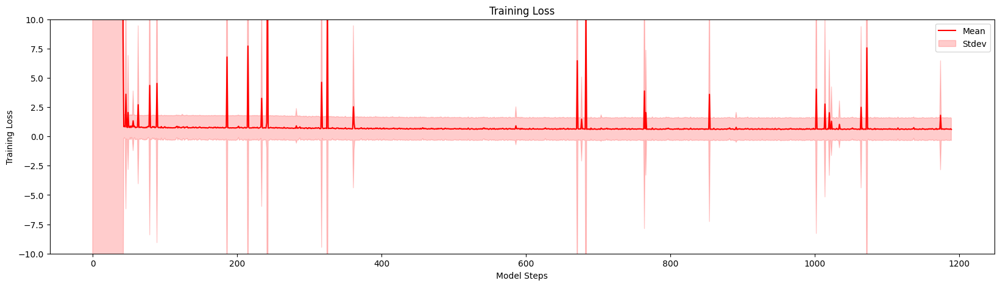

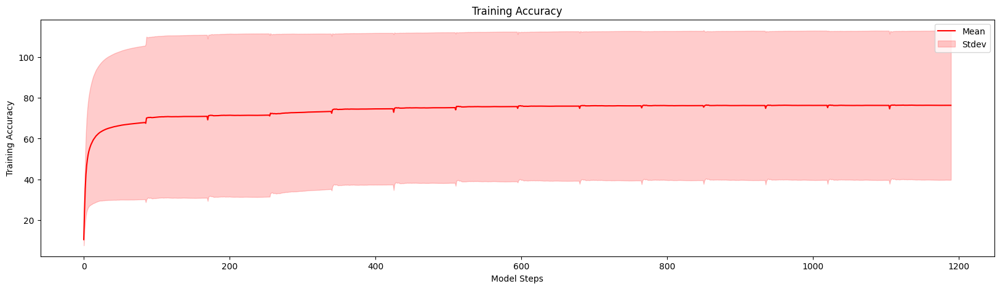

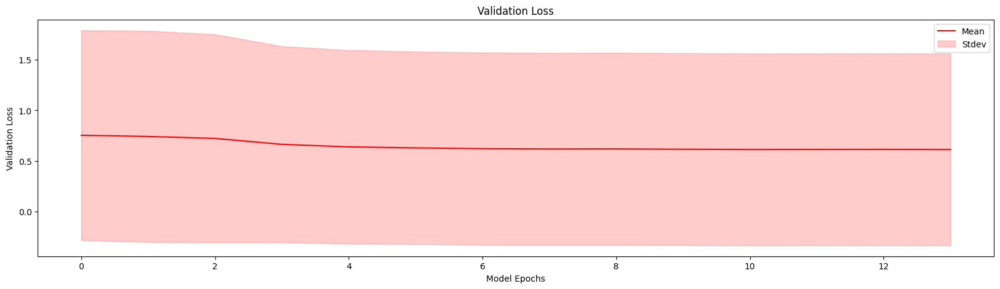

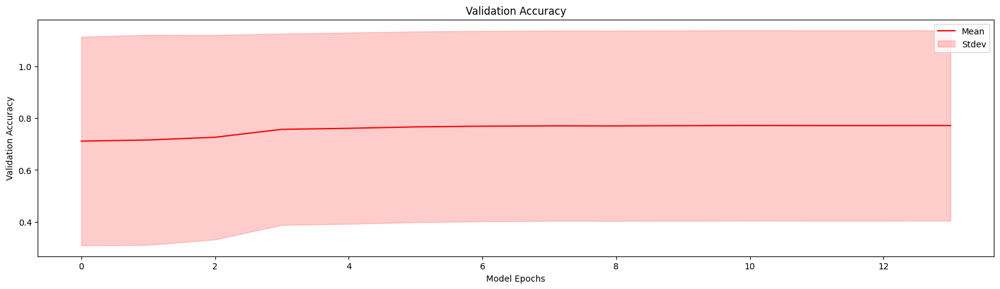

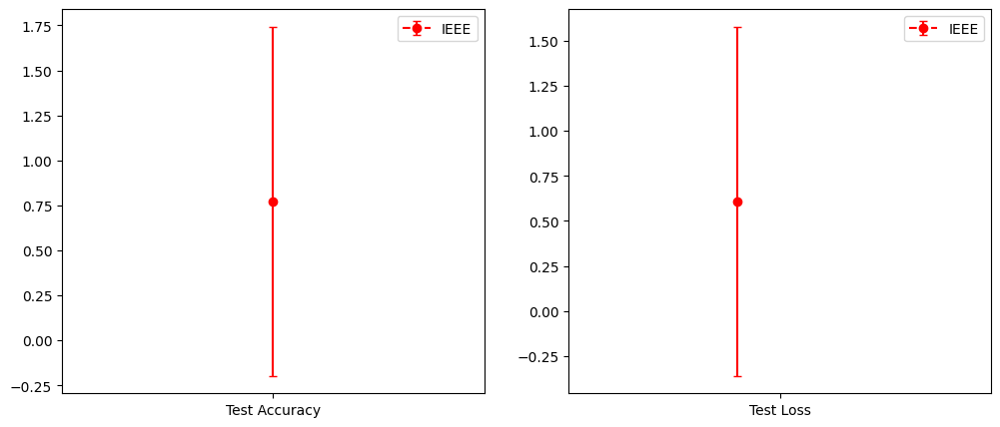

In [6]:
# Training Loss
plt.figure(figsize=(20, 5))
mean = np.array([data['train_loss'] for data in results.values()]).mean(axis=0)
stdev = np.array([data['train_loss'] for data in results.values()]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
plt.ylim(-10,10)
plt.legend(), plt.title('Training Loss');

# Training Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['train_accuracy'] for data in results.values()]).mean(axis=0)
stdev = np.array([data['train_accuracy'] for data in results.values()]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Training Accuracy');

# Validation Loss
plt.figure(figsize=(20, 5))
mean = np.array([data['val_loss'] for data in results.values()]).mean(axis=0)
stdev = np.array([data['val_loss'] for data in results.values()]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Loss')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Loss');

# Validation Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['val_accuracy'] for data in results.values()]).mean(axis=0)
stdev = np.array([data['val_accuracy'] for data in results.values()]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Accuracy');

# Test Loss
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.array([data['test_accuracy'] for data in results.values()]).mean(), yerr=np.array([data['val_loss'] for data in results.values()]).std(), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", label='IEEE')
axes[0].set_xticks([1], ['Test Accuracy']), axes[0].legend()
axes[0].set_xlim(0.95,1.05)
axes[1].errorbar([0.99], np.array([data['test_loss'] for data in results.values()]).mean(), yerr=np.array([data['val_loss'] for data in results.values()]).std(), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", label='IEEE')
axes[1].set_xticks([1], ['Test Loss']), axes[1].legend();
axes[1].set_xlim(0.95,1.05);


### All weight initializations (excluding normal, ones, zeros)

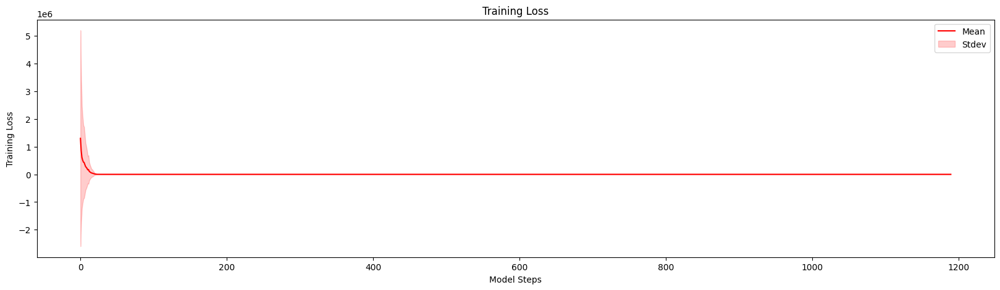

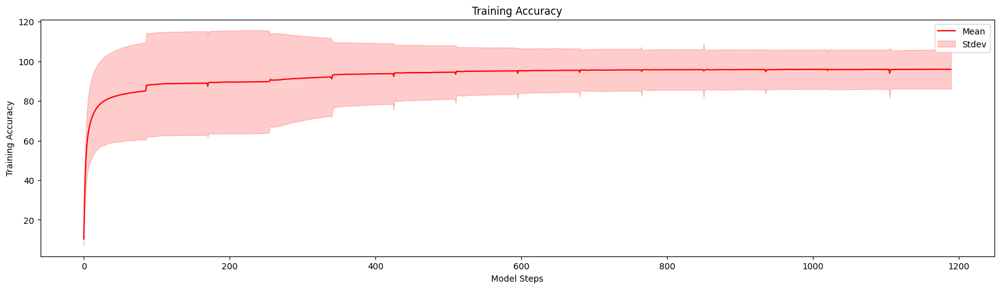

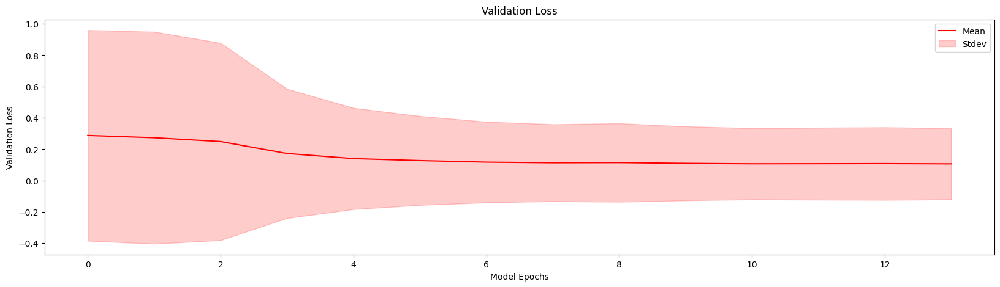

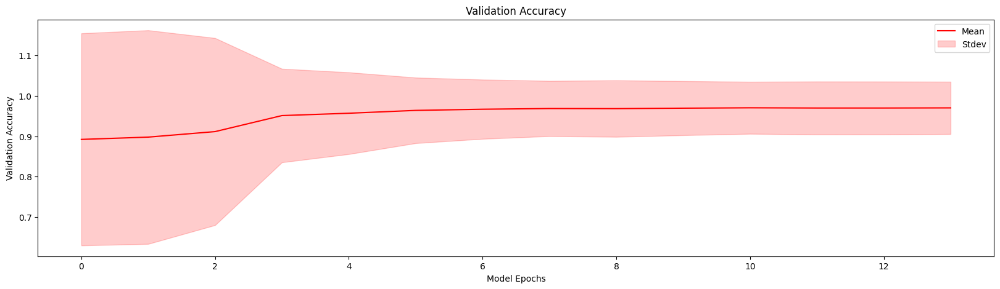

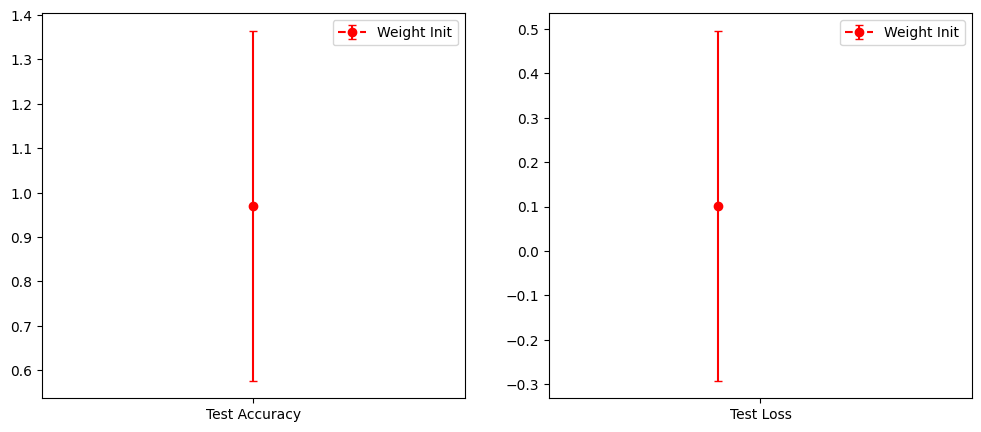

In [7]:
# Training Loss
plt.figure(figsize=(20, 5))
mean = np.array([data['train_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(axis=0)
stdev = np.array([data['train_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
# plt.ylim(-10,10)
plt.legend(), plt.title('Training Loss');

# Training Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['train_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(axis=0)
stdev = np.array([data['train_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Training Accuracy');

# Validation Loss
plt.figure(figsize=(20, 5))
mean = np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(axis=0)
stdev = np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Loss')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Loss');

# Validation Accuracy
plt.figure(figsize=(20, 5))
mean = np.array([data['val_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(axis=0)
stdev = np.array([data['val_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
# plt.ylim(-10,10)
plt.legend(), plt.title('Validation Accuracy');

# Test Loss
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.array([data['test_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(), yerr=np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", label='Weight Init')
axes[0].set_xticks([1], ['Test Accuracy']), axes[0].legend()
axes[0].set_xlim(0.95,1.05)
axes[1].errorbar([0.99], np.array([data['test_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).mean(), yerr=np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']]).std(), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", label='Weight Init')
axes[1].set_xticks([1], ['Test Loss']), axes[1].legend();
axes[1].set_xlim(0.95,1.05);


### Comparison to MCA and Random Seeds

In [4]:
# IEEE
ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_mnist_train', iter=11, hessian=False, filetype='log')# Fuzzy SR

# Fuzzy SR
sr_train_loss, sr_val_loss, sr_test_loss, sr_train_accuracy, sr_val_accuracy, sr_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False, filetype='log')
# Random Seed
random_train_loss, random_val_loss, random_test_loss, random_train_accuracy, random_val_accuracy, random_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_v2_mnist_train', hessian=False, iter=11, filetype='log')


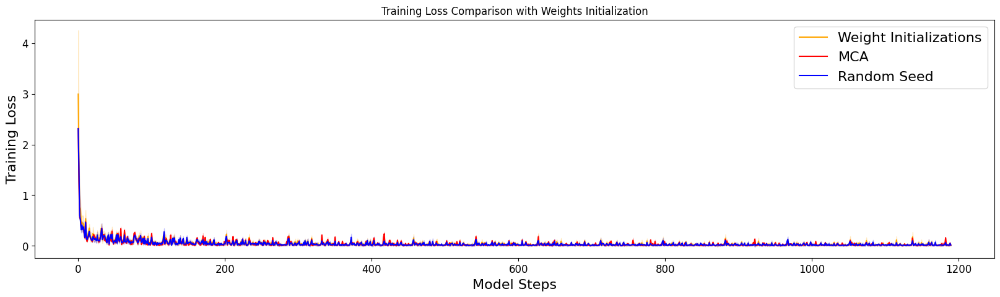

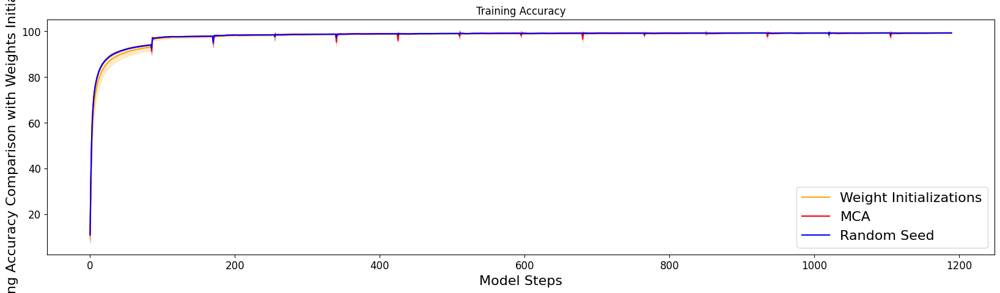

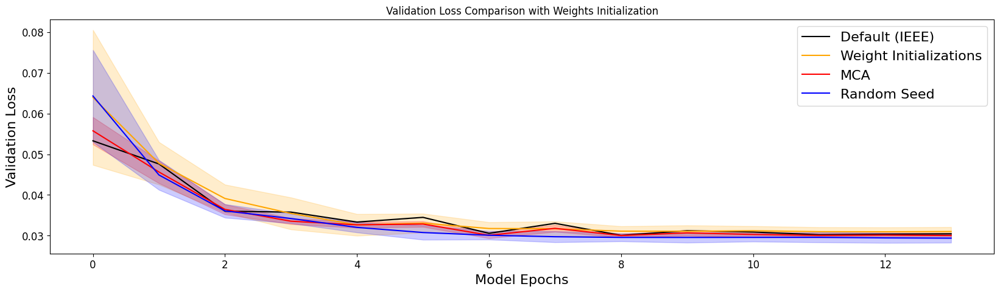

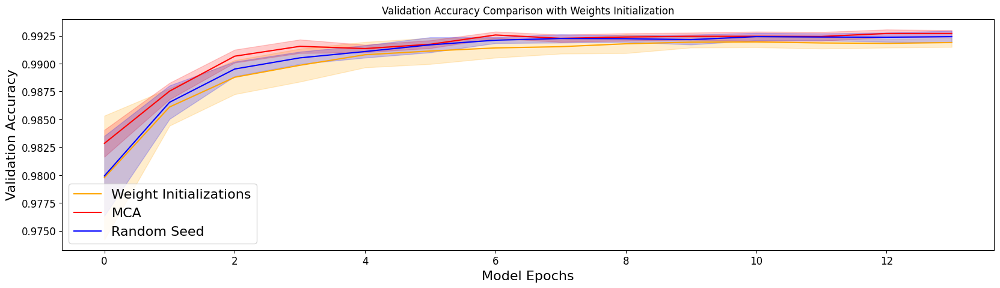

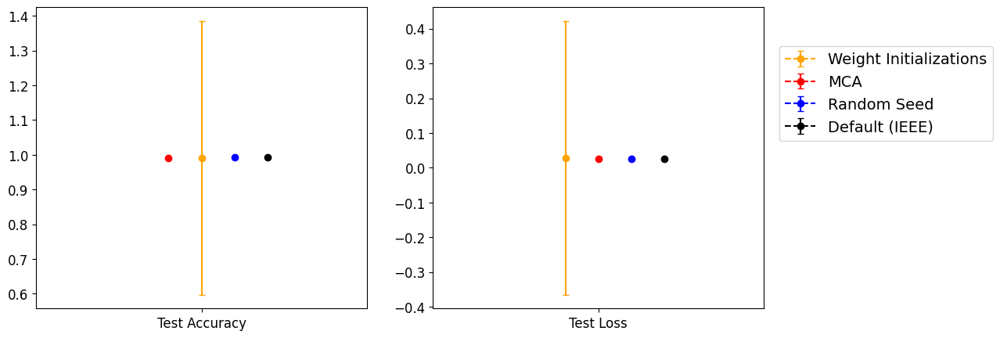

In [5]:
## Training Loss
plt.figure(figsize=(20, 5))
# Weights Init 
mean = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['train_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Weight Initializations', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2,)
# Fuzzy SR
mean = sr_train_loss.mean(axis=0)
stdev = sr_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='MCA', color='red')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, )
#Random Seed
mean = random_train_loss.mean(axis=0)
stdev = random_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Seed', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, )

plt.xlabel('Model Steps', fontsize=16), plt.ylabel('Training Loss', fontsize=16)
plt.tick_params(axis='both', which='major', labelsize=12)
# plt.ylim(-10,10)
plt.legend(fontsize=16), plt.title('Training Loss Comparison with Weights Initialization');

## Training Accuracy
plt.figure(figsize=(20, 5))
# Weights Init 
mean = np.array([data['train_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']]).mean(axis=0)
stdev = np.array([data['train_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Weight Initializations', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, )
#Fuzzy SR
mean = sr_train_accuracy.mean(axis=0)
stdev = sr_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='MCA', color='red', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, )
#Random Seed
mean = random_train_accuracy.mean(axis=0)
stdev = random_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Seed', color='blue', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2,)

plt.xlabel('Model Steps', fontsize=16), plt.ylabel('Training Accuracy Comparison with Weights Initialization', fontsize=16)
plt.tick_params(axis='both', which='major', labelsize=12)
# plt.ylim(-10,10)
plt.legend(fontsize=16), plt.title('Training Accuracy');
plt.savefig('/home/inesgp/cnn_training/figures/weight_init_train_acc.pdf', bbox_inches='tight')

## Validation Loss
plt.figure(figsize=(20, 5))
# IEEE 
mean = ieee_val_loss.mean(axis=0)
stdev = ieee_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Default (IEEE)', color='black')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, )
# Weights Init 
mean = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).mean(axis=0)
stdev = np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Weight Initializations', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, )
#Fuzzy SR
mean = sr_val_loss.mean(axis=0)
stdev = sr_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='MCA', color='red')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, )
#Random
mean = random_val_loss.mean(axis=0)
stdev = random_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Seed', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, )

plt.xlabel('Model Epochs', fontsize=16), plt.ylabel('Validation Loss', fontsize=16)
plt.tick_params(axis='both', which='major', labelsize=12)
# plt.ylim(-10,10)
plt.legend(fontsize=16), plt.title('Validation Loss Comparison with Weights Initialization');
plt.savefig('/home/inesgp/cnn_training/figures/weight_init_val_loss.pdf', bbox_inches='tight')

## Validation Accuracy
plt.figure(figsize=(20, 5))
# Weights Init 
mean = np.array([data['val_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']]).mean(axis=0)
stdev = np.array([data['val_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']]).std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Weight Initializations', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, )
# Fuzzy SR
mean = sr_val_accuracy.mean(axis=0)
stdev = sr_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='MCA', color='red')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='red', alpha=0.2, )
# Random
mean = random_val_accuracy.mean(axis=0)
stdev = random_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Seed', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, )

plt.xlabel('Model Epochs', fontsize=16), plt.ylabel('Validation Accuracy', fontsize=16)
plt.tick_params(axis='both', which='major', labelsize=12)
# plt.ylim(-10,10)
plt.legend(fontsize=16), plt.title('Validation Accuracy Comparison with Weights Initialization');
# plt.savefig('/home/inesgp/cnn_training/figures/weight_init_val_acc.pdf', bbox_inches='tight')

## Test Loss & Accuracy
fig, axes = plt.subplots(1,2, figsize=(12,5))
# Weights Init 
axes[0].errorbar([1], np.nan_to_num(np.array([data['test_accuracy'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Weight Initializations')
# Fuzzy SR
axes[0].errorbar([0.99], np.mean(sr_test_accuracy), yerr=np.std(sr_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", label='MCA')
# Random
axes[0].errorbar([1.01], np.mean(random_test_accuracy), yerr=np.std(random_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Random Seed')
# IEEE
axes[0].errorbar([1.02], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='Default (IEEE)')

axes[0].set_xticks([1], ['Test Accuracy'], fontsize=16), #axes[0].legend(fontsize=16)
axes[0].set_xlim(0.95,1.05)
axes[0].tick_params(axis='both', which='major', labelsize=12)

# Weights Init 
axes[1].errorbar([0.99], np.nan_to_num(np.array([data['test_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones', 'uniform']])).mean(), 
                 yerr=np.nan_to_num(np.array([data['val_loss'] for init, data in results.items() if init not in ['normal', 'zeros', 'ones']])).std(), 
                 capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", )
# Fuzzy SR
axes[1].errorbar([1], np.mean(sr_test_loss), yerr=np.std(sr_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "red", color = "red", )
# Random
axes[1].errorbar([1.01], np.mean(random_test_loss), yerr=np.std(random_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", )
# IEEE
axes[1].errorbar([1.02], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", )


axes[1].set_xticks([1], ['Test Loss'], fontsize=16), #axes[1].legend(fontsize=16)
fig.legend(fontsize=14, loc='upper center', bbox_to_anchor=(1.03,0.8))
# axes[0].set_yscale('log')
# axes[1].set_yscale('log')
axes[1].set_xlim(0.95,1.05)
axes[1].tick_params(axis='both', which='major', labelsize=12)
# plt.suptitle('Test Metrics Comparison with Weights Initialization');
plt.savefig('/home/inesgp/cnn_training/figures/weight_init_test.pdf', bbox_inches='tight')


## Model Outputs

### Dice Scores

In [11]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, 1)
        self.conv2 = nn.Conv2d(32, 64, 3, 1)
        self.dropout1 = nn.Dropout(0.25)
        self.dropout2 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(9216, 128)
        self.fc2 = nn.Linear(128, 10)

    def forward(self, x):
        x = self.conv1(x)
        x = F.relu(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = F.max_pool2d(x, 2)
        x = self.dropout1(x)
        x = torch.flatten(x, 1)
        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout2(x)
        x = self.fc2(x)
        output = F.log_softmax(x, dim=1)
        return output

def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    metrics = {'output': [], 'pred':[], 'target':[], 'loss': []}
    #metrics = {'pred':[], 'target':[] }
    with torch.no_grad():
        for data, target in test_loader:
            #logger.info(f'Before {data.shape}')
            data, target = data.to(device), target.to(device)
            output = model(data)
            batch_loss = F.nll_loss(output, target, reduction='sum').item() 
            test_loss += batch_loss  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

            # metrics['loss'].append( batch_loss/data.size(0) )
            # metrics['output'].append(output)
            metrics['pred'].append(pred.item())
            # metrics['target'].append(target.item())
            #logger.info(f'After {data.shape}')

    test_loss /= len(test_loader.dataset)

    # print(f'\nTest set: Average loss: {test_loss}')
    print('\nTest set: Average loss: {:}, Accuracy: {}/{} ({:}%)\n'.format(
       test_loss, correct, len(test_loader.dataset),
       100. * correct / len(test_loader.dataset)))

    return metrics


torch.manual_seed(0)
random.seed(0)
np.random.seed(0)

device = torch.device("cpu")


transform=transforms.Compose([
transforms.ToTensor(),
transforms.Normalize((0.1307,), (0.3081,))
])

dataset2 = datasets.MNIST(f'/home/inesgp/mnist/data', train=False,
                    transform=transform)
generator = torch.Generator()
generator.manual_seed(0)
test_loader = torch.utils.data.DataLoader(dataset2, generator=generator,)

model = Net().to(device)

metrics = {'random seed': [], 'fuzzy': [], 'weight init': []}
for i in range(1,12):

    if i != 11:
        model.load_state_dict(torch.load(f'/home/inesgp/cnn_training/random_seeds/randomseed_mnist_cnn_{i}.pt'))
        metrics['random seed'].append( test(model, device, test_loader, )['pred'] )
        model.load_state_dict(torch.load(f'/home/inesgp/cnn_training/fuzzy_sr/mnist_cnn_{i}.pt'))
        metrics['fuzzy'].append( test(model, device, test_loader, )['pred'] )
    model.load_state_dict(torch.load(f'/home/inesgp/cnn_training/weight_init/mnist_cnn_{i}.pt'))
    metrics['weight init'].append( test(model, device, test_loader, )['pred'] )



Test set: Average loss: 0.03637657216214247, Accuracy: 9915/10000 (99.15%)


Test set: Average loss: 0.027118280199508397, Accuracy: 9917/10000 (99.17%)


Test set: Average loss: 2.3010432512283323, Accuracy: 1135/10000 (11.35%)


Test set: Average loss: 0.03654155637076474, Accuracy: 9915/10000 (99.15%)


Test set: Average loss: 0.028893208171009155, Accuracy: 9905/10000 (99.05%)


Test set: Average loss: 2.3010058433055876, Accuracy: 1135/10000 (11.35%)


Test set: Average loss: 0.035412509988879515, Accuracy: 9910/10000 (99.1%)


Test set: Average loss: 0.025534667671810795, Accuracy: 9913/10000 (99.13%)


Test set: Average loss: 0.028483125996114852, Accuracy: 9910/10000 (99.1%)


Test set: Average loss: 0.036542419738792055, Accuracy: 9911/10000 (99.11%)


Test set: Average loss: 0.026929825824581956, Accuracy: 9917/10000 (99.17%)


Test set: Average loss: 0.034825621528332955, Accuracy: 9882/10000 (98.82%)


Test set: Average loss: 0.03575545164328065, Accuracy: 9917/10000 (99.1

In [20]:
from scipy.spatial.distance import pdist

dice_scores = {'random seed': [], 'fuzzy': [], 'weight init': []}
for name, var in metrics.items():
    dice_scores[name] = pdist(var, metric='dice', ) 

In [ ]:
def plot(dice_scores, title=''):
    # Build a long-format dataframe
    data = []
    # Custom labels
    custom_labels = {"random seed": "Random Seed",
        "fuzzy": "MCA",
        "weight init": "Weight Initialization"
    }

    for name, var in dice_scores.items():
        for v in var:
            data.append({"Variability Methods": custom_labels[name], "Dice Scores": v})

    df = pd.DataFrame(data)

    fig = px.strip(df, x="Variability Methods", y="Dice Scores", color="Variability Methods", title=title, )


    fig.update_layout(
        
        xaxis=dict(
            title='Variability Methods',
            title_font=dict(size=24),
            tickfont=dict(size=22),
        ),
        yaxis=dict(
            title='Dice Scores',
            title_font=dict(size=24),
            tickfont=dict(size=22),
            # range=[0.99, 1.01]
        ),
        showlegend=False,
    )

    fig.show()



def compute_pairwise_dice(preds, num_classes=10):
    # num_preds = preds.shape[0]
    # dice_matrix = np.zeros(num_preds, num_preds)

    # One-hot encode all predictions
    one_hot = np.eye(num_classes)[preds]

    # Pairwise Dice
    A = one_hot[:, None, :, :]
    B = one_hot[None, :, :, :]

    # Intersection and sums over class axis
    intersection = np.sum(A * B, axis=2) # shape: [10, 10, C]
    A_sum = np.sum(A, axis=2) # shape: [10, 1, C]
    B_sum = np.sum(B, axis=2) # shape: [1, 10, C]

    denom = A_sum + B_sum 
    dice_per_class = 2 * intersection / np.clip(denom, a_min=1e-8, a_max=None) # shape: [10, 10, C]

    # Mean over classes to get final pairwise Dice score
    dice_per_class = dice_per_class.mean(axis=2)

    i_upper, j_upper = np.triu_indices(dice_per_class.shape[0], k=1)
    return dice_per_class[i_upper, j_upper] #unique pairs
     


dice_scores = {'random seed': [], 'fuzzy': [], 'weight init': []}
for name, var in metrics.items():
    if name == 'weight init': dice_scores[name] = compute_pairwise_dice(var[3:-1] ) 
    else: dice_scores[name] = compute_pairwise_dice(var ) 

plot(dice_scores, title='Best Performing Weight Initializations')

dice_scores = {'random seed': [], 'fuzzy': [], 'weight init': []}
for name, var in metrics.items():
    if name == 'weight init': dice_scores[name] = compute_pairwise_dice(var ) 
    else: dice_scores[name] = compute_pairwise_dice(var ) 

plot(dice_scores, title='All Weight Initializations')

### Test Eval in IEEE

**Class Labels**

In [8]:
DIR = '/home/inesgp/cnn_training/slurm'

loss = []
accuracy = []

for i in range(1,6):


    file = open(f"{DIR}/fuzzy_mnist_train_{i}.out", 'r')

    for line in file: 
        if "loss" in line:
            loss.append( float(line.split('loss: ')[-1].split(',')[0]) )
            accuracy.append( float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[0]) / float(line.split('Accuracy: ')[-1].split(' (')[0].split('/')[1]))


Accuracy coefficient of variation: 0.0002419306062377508
Loss coefficient of variation: 0.03772809119601465


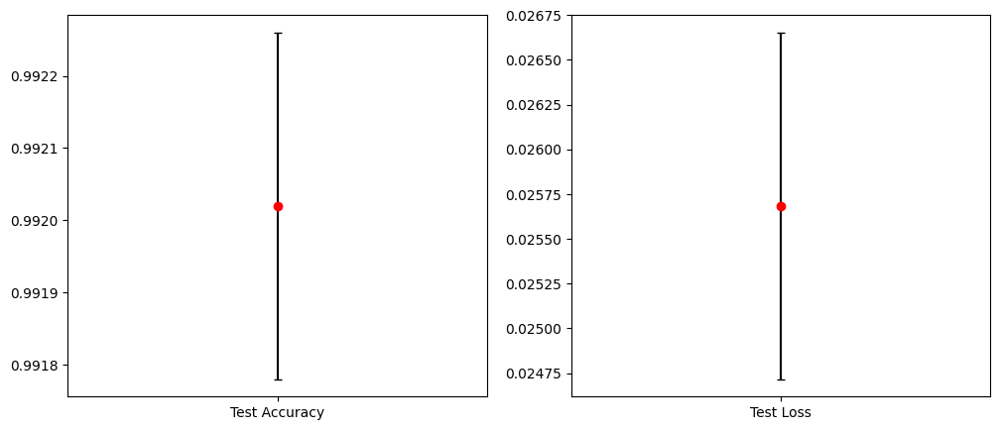

In [20]:
fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(accuracy), yerr=np.std(accuracy), capsize=3, fmt="r--o", ecolor = "black")
axes[0].set_xticks([1], ['Test Accuracy'])
axes[1].errorbar([1], np.mean(loss), yerr=np.std(loss), capsize=3, fmt="r--o", ecolor = "black")
axes[1].set_xticks([1], ['Test Loss'])

print(f"Accuracy coefficient of variation: {np.std(accuracy) / abs(np.mean(accuracy))}")
print(f"Loss coefficient of variation: {np.std(loss) / abs(np.mean(loss))}")

**Class Probabilities**

In [2]:
def compile_results(dir_name, ):
    pred = {}
    target = {} 
    output = {}
    loss = {}
    for num in range(1,6):
    
        res = pickle.load(open(f'{dir_name}/test_metrics_{num}.pkl', 'rb'))
        # res = pickle.load(open('mnist_results_full/mnist_results_1.pkl', 'rb'))
    
        tmp_pred = torch.tensor([])
        tmp_target = torch.tensor([])
        tmp_output = torch.tensor([])
        tmp_loss = []
        
        for i in res.keys():
            for k in res[i]:
                # print(k)
                if i == 'pred': tmp_pred = torch.cat((tmp_pred, k))
                elif i == 'target': tmp_target = torch.cat((tmp_target, k))
                elif i == 'output': tmp_output = torch.cat((tmp_output, k))
                elif i == 'loss': tmp_loss.append(k)
    
        # print(tmp_output.shape)
        pred[num] = tmp_pred.numpy() 
        target[num] = tmp_target.numpy() 
        output[num] = tmp_output.numpy() 
        loss[num] = tmp_loss

    return pred, target, output, loss

def metric_unstability(pred, target, loss):

    #gotten from slurm output
    #TODO save to file
    # avg_loss = [0.025298748701810838, 0.025298750564455987, 0.025298746135830878, 0.02529873021543026, 0.025298738285899163, 
    #         0.025298739501833915, 0.02529874346256256, 0.02529875337779522, 0.025298740258812905, 0.0252987517952919]

    acc = []
    macro_f1 = []
    weighted_f1 = []
    macro_precision = []
    weighted_precision = []
    macro_recall = []
    weighted_recall = []
    
    for i, j in zip(target, pred):
        acc.append(accuracy_score(target[i], pred[j]))
        macro_f1.append(f1_score(target[i], pred[j], average='macro'))
        weighted_f1.append(f1_score(target[i], pred[j], average='weighted'))
        macro_precision.append(precision_score(target[i], pred[j], average='macro'))
        weighted_precision.append(precision_score(target[i], pred[j], average='weighted'))
        macro_recall.append(recall_score(target[i], pred[j], average='macro'))
        weighted_recall.append(recall_score(target[i], pred[j], average='weighted'))
    
    # results = {'Accuracy': acc, 'Macro F1': macro_f1, 'Macro Precision': macro_precision, 'Macro Recall': macro_recall, 
    #            'Average Loss': avg_loss}
    
    results = {'Accuracy': acc, 'Macro F1': macro_f1, 'Weighted F1': weighted_f1, 'Macro Precision': macro_precision, 
               'Weighted Precision': weighted_precision, 'Macro Recall': macro_recall, 'Weighted Recall': weighted_recall, 
               'Average Loss per Batch': loss}
    metrics = {}
    for m in results:
        if 'Average Loss per Batch' == m:
            metrics[m] = {'Mean': [np.mean(np.mean(np.array(list(loss.values())),axis=0))], 
                          'Standard Deviation': [np.mean(np.std(np.array(list(loss.values())),axis=0))],
                          'Significant Digits': [ np.mean( sd.significant_digits(np.array(list(loss.values()), dtype=np.float32), reference=np.mean(np.array(list(loss.values())), axis=0, dtype=np.float32),  basis=10, error=Error.Relative) ) ]  }
        else: metrics[m] = {'Mean': [statistics.mean(results[m])], 'Standard Deviation': [statistics.stdev(results[m])], 'Significant Digits': [sd.significant_digits(np.array(results[m], dtype=np.float32), reference=np.mean(results[m], dtype=np.float32),  basis=10, error=Error.Relative)] }



    df = pd.concat( [pd.DataFrame(metrics['Accuracy']), pd.DataFrame(metrics['Macro F1']), pd.DataFrame(metrics['Weighted F1']),
                pd.DataFrame(metrics['Macro Precision']), pd.DataFrame(metrics['Weighted Precision']),
                pd.DataFrame(metrics['Macro Recall']), pd.DataFrame(metrics['Weighted Recall']), 
                     pd.DataFrame(metrics['Average Loss per Batch'])] )
    
    df.index = ['Accuracy', 'Macro F1', 'Weighted F1', 'Macro Precision', 'Weighted Precision', 'Macro Recall', 'Weighted Recall',
                'Average Loss per Batch'] 
    
    # df.loc[df.index != "Average Loss per Batch", "Mean"] *= 100

    
    return df


fuzzy_sr_pred, fuzzy_sr_target, fuzzy_sr_output, fuzzy_sr_loss = compile_results('/home/inesgp/cnn_training/fuzzy_sr', )


In [30]:
ieee_pred, ieee_target, ieee_output, ieee_loss = compile_results('/home/inesgp/cnn_training/ieee', )


In [25]:
ieee_pred = {}
ieee_target = {} 
ieee_output = {}
ieee_loss = {}
for num in range(1,2):

    res = pickle.load(open(f'/home/inesgp/cnn_training/ieee_test_metrics_1.pkl', 'rb'))

    tmp_pred = torch.tensor([])
    tmp_target = torch.tensor([])
    tmp_output = torch.tensor([])
    tmp_loss = []
    
    for i in res.keys():
        for k in res[i]:
            # print(k)
            if i == 'pred': tmp_pred = torch.cat((tmp_pred, k))
            elif i == 'target': tmp_target = torch.cat((tmp_target, k))
            elif i == 'output': tmp_output = torch.cat((tmp_output, k))
            elif i == 'loss': tmp_loss.append(k)

    # print(tmp_output.shape)
    ieee_pred[num] = tmp_pred.numpy() 
    ieee_target[num] = tmp_target.numpy() 
    ieee_output[num] = tmp_output.numpy() 
    ieee_loss[num] = tmp_loss

In [25]:
fuzzy_sr_df = metric_unstability(fuzzy_sr_pred, fuzzy_sr_target, fuzzy_sr_loss)
fuzzy_sr_df


,Mean,Standard Deviation,Significant Digits
Accuracy,0.992020,0.000268,2.865719
Macro F1,0.991960,0.000267,2.868058
Weighted F1,0.992017,0.000269,2.864771
Macro Precision,0.991995,0.000268,2.865912
Weighted Precision,0.992029,0.000269,2.864763
Macro Recall,0.991941,0.000265,2.870594
Weighted Recall,0.992020,0.000268,2.865719
Average Loss per Batch,0.025684,0.001541,0.370028


In [ ]:
np.stack(list(fuzzy_sr_output.values())).shape, np.stack(list(fuzzy_sr_pred.values())).shape

((5, 10000, 10), (5, 10000, 1))

**What is the variability across MNIST models for each class probability?**


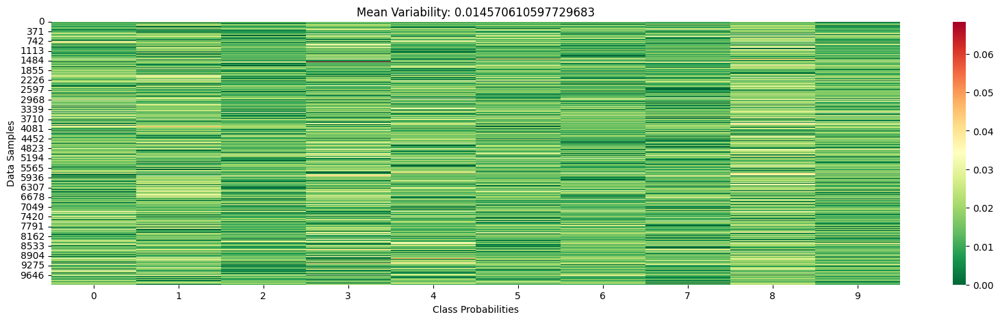

In [6]:
arr = np.stack(list(fuzzy_sr_output.values()))
min_vals = arr.min(axis=(0, 1), keepdims=True)
max_vals = arr.max(axis=(0, 1), keepdims=True)
normalized = (arr - min_vals) / (max_vals - min_vals)

fig, axes = plt.subplots(1,1, figsize=(20,5))
g = sns.heatmap(normalized.std(axis=0), ax=axes, cmap='RdYlGn_r', )
g.set_xlabel('Class Probabilities'), g.set_ylabel('Data Samples')
g.set_title(f"Mean Variability: {normalized.std(axis=0).mean()}");

In [3]:
arr = np.stack(list(fuzzy_sr_output.values()))
min_vals = arr.min(axis=(0, 1), keepdims=True)
max_vals = arr.max(axis=(0, 1), keepdims=True)
normalized = (arr - min_vals) / (max_vals - min_vals)

iterations, samples, classes = normalized.shape

df = pd.DataFrame({
    'Iteration': np.repeat(np.arange(iterations), samples * classes),
    # 'Sample Index': np.tile(np.repeat(np.arange(samples), classes), iterations),
    'Class': np.tile(np.arange(classes), iterations * samples),
    'Probability': normalized.flatten()
})

df.head()

,Iteration,Class,Probability
0,0,0,0.511757
1,0,1,0.536348
2,0,2,0.651840
3,0,3,0.561666
4,0,4,0.503205


In [37]:
def calculate_df(variances):

    df_dict = {}

    for class_idx in range(variances.shape[1]):
        var_values = variances[:, class_idx]
        sample_indices = np.arange(variances.shape[0])
        
        df_dict[f'Sample Index {class_idx+1}'] = sample_indices
        df_dict[f'Mean Variance Class Prob {class_idx+1}'] = var_values

    df = pd.DataFrame(df_dict)

    # Assuming df is your wide DataFrame with pairs of Sample Index and Variance columns
    n_classes = len(df.columns) // 2  # Each class has 2 columns

    # Prepare long-format data
    long_data = []

    for class_idx in range(n_classes):
        sample_idx_col = f'Sample Index {class_idx+1}'
        variance_col = f'Mean Variance Class Prob {class_idx+1}'

        class_df = pd.DataFrame({
            'Sample Index': df[sample_idx_col],
            'Mean Variance': df[variance_col],
            'Class': f'Class {class_idx+1}'
        })
        long_data.append(class_df)

    long_df = pd.concat(long_data, ignore_index=True)
    return long_df

arr = np.stack(list(fuzzy_sr_output.values()))
min_vals = arr.min(axis=(0, 1), keepdims=True)
max_vals = arr.max(axis=(0, 1), keepdims=True)
normalized = (arr - min_vals) / (max_vals - min_vals)
variances = np.var(normalized, axis=0, ddof=0)
long_df = calculate_df(variances)

ieee = np.stack(list(ieee_output.values()))
min_vals = ieee.min(axis=(0, 1), keepdims=True)
max_vals = ieee.max(axis=(0, 1), keepdims=True)
normalized = (ieee - min_vals) / (max_vals - min_vals)
ieee_variances = np.var(normalized, axis=0, ddof=0)
ieee_long_df = calculate_df(ieee_variances)

# Step 2: Mean variance per sample across classes, shape: (10000,)
# sample_variances = np.mean(variances, axis=1)

fig = px.violin(
    long_df,
    x='Class',
    y='Mean Variance',
    box=True,
    points='all',
    hover_data=['Sample Index']
)
# fig = px.violin(
#     ieee_long_df,
#     x='Class',
#     y='Mean Variance',
#     box=True,
#     points='all',
#     hover_data=['Sample Index']
# )
fig.show()


In [36]:
ieee_long_df['Mean Variance'].mean()

1.1684567e-16

### IEEE Training

In [3]:
# IEEE
# ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy, ieee_hessian_1, ieee_hessian_2 = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_train', iter=6, hessian=True)
ieee_train_loss, ieee_val_loss, ieee_test_loss, ieee_train_accuracy, ieee_val_accuracy, ieee_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='ieee_mnist_train', iter=11, hessian=False, filetype='log')# Fuzzy SR
#Fuzzy SR
# sr_train_loss, sr_val_loss, sr_test_loss, sr_train_accuracy, sr_val_accuracy, sr_test_accuracy = process_log(dir='/home/inesgp/mnist/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False)
sr_train_loss, sr_val_loss, sr_test_loss, sr_train_accuracy, sr_val_accuracy, sr_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False, filetype='log')
# Fuzzy UD
ud_train_loss, ud_val_loss, ud_test_loss, ud_train_accuracy, ud_val_accuracy, ud_test_accuracy = process_log(dir='/home/inesgp/mnist/slurm', filename='fuzzy_mnist_train_ud', iter=11, hessian=False)
# Random Seed
# random_train_loss, random_val_loss, random_test_loss, random_train_accuracy, random_val_accuracy, random_test_accuracy, random_hessian_1, random_hessian_2 = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_mnist_train', hessian=True)
random_train_loss, random_val_loss, random_test_loss, random_train_accuracy, random_val_accuracy, random_test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_v2_mnist_train', hessian=False, iter=11, filetype='log')


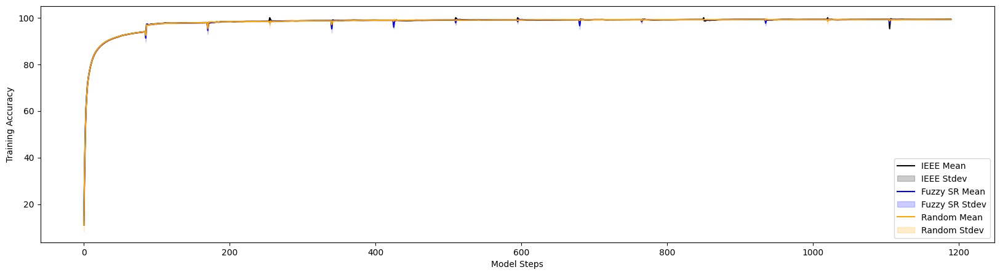

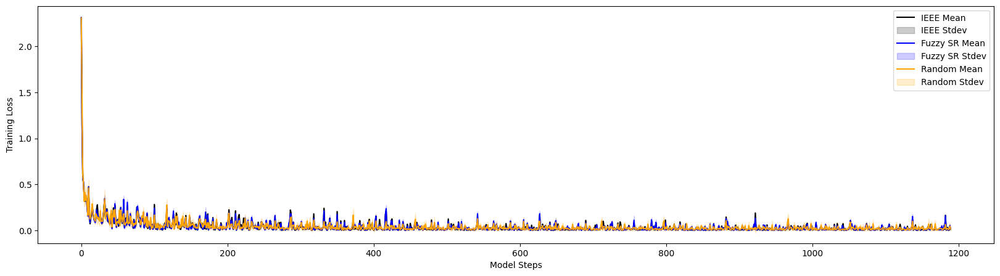

In [4]:
plt.figure(figsize=(20, 5))
#IEEE
mean = ieee_train_accuracy.mean(axis=0)
stdev = ieee_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
#Fuzzy SR
mean = sr_train_accuracy.mean(axis=0)
stdev = sr_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# #Fuzzy UD
# mean = ud_train_accuracy.mean(axis=0)
# stdev = ud_train_accuracy.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green', )
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random Seed
mean = random_train_accuracy.mean(axis=0)
stdev = random_train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')

plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy')
# plt.ylim(95,100)
plt.legend();

plt.figure(figsize=(20, 5))
#IEEE
mean = ieee_train_loss.mean(axis=0)
stdev = ieee_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
# Fuzzy SR
mean = sr_train_loss.mean(axis=0)
stdev = sr_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# # Fuzzy UD
# mean = ud_train_loss.mean(axis=0)
# stdev = ud_train_loss.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random Seed
mean = random_train_loss.mean(axis=0)
stdev = random_train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
# plt.ylim(0,0.3)
plt.legend();

# plt.figure(figsize=(20, 5))
# #IEEE
# mean = ieee_hessian_1.mean(axis=0)
# stdev = ieee_hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='IEEE Stdev')
# #Fuzzy SR
# mean = sr_hessian_1.mean(axis=0)
# stdev = sr_hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# #Random
# mean = random_hessian_1.mean(axis=0)
# stdev = random_hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')
# plt.xlabel('Model Steps'), plt.ylabel('Training Hessian Top First Eigenvalue')
# # plt.ylim(0,0.3)
# plt.legend();

# plt.figure(figsize=(20, 5))
# #IEEE
# mean = ieee_hessian_2.mean(axis=0)
# stdev = ieee_hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='IEEE Stdev')
# #Fuzzy SR
# mean = sr_hessian_2.mean(axis=0)
# stdev = sr_hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# #Random
# mean = random_hessian_2.mean(axis=0)
# stdev = random_hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')
# plt.xlabel('Model Steps'), plt.ylabel('Training Hessian Top Second Eigenvalue')
# # plt.ylim(0,0.3)
# plt.legend();

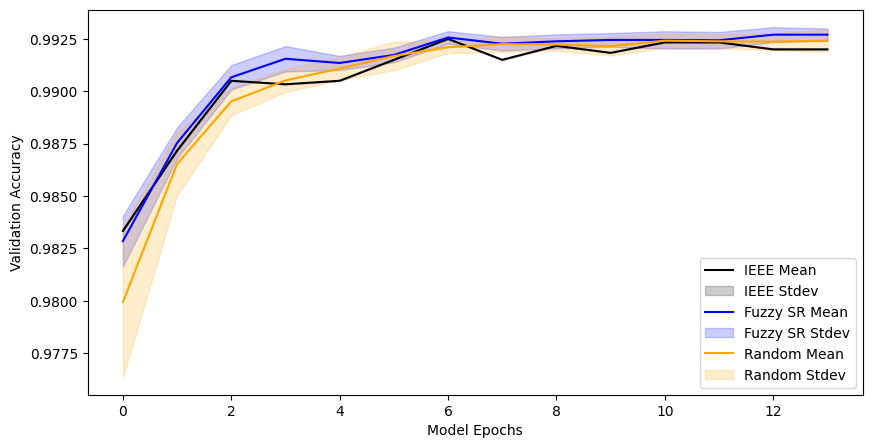

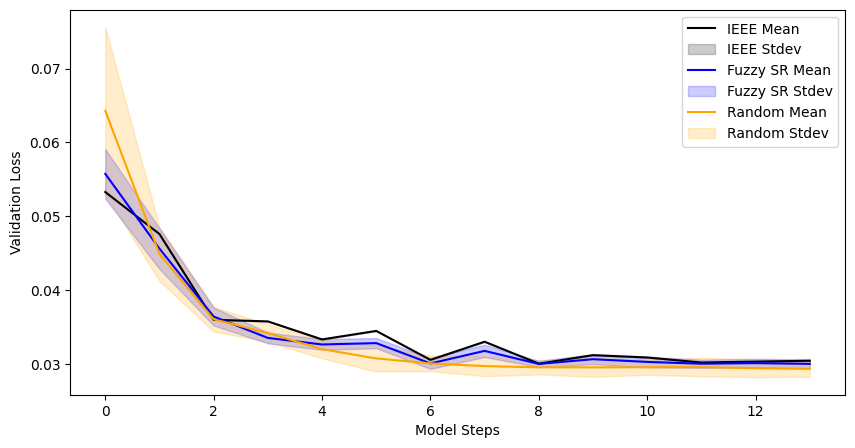

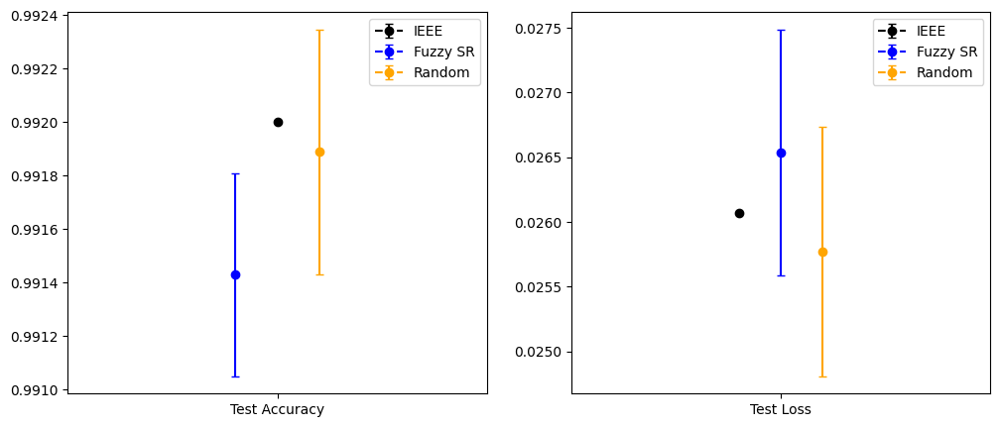

In [5]:
plt.figure(figsize=(10, 5))
#IEEE
mean = ieee_val_accuracy.mean(axis=0)
stdev = ieee_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
#Fuzzy SR
mean = sr_val_accuracy.mean(axis=0)
stdev = sr_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# #Fuzzy UD
# mean = ud_val_accuracy.mean(axis=0)
# stdev = ud_val_accuracy.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random
mean = random_val_accuracy.mean(axis=0)
stdev = random_val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
plt.legend();

plt.figure(figsize=(10, 5))
#IEEE
mean = ieee_val_loss.mean(axis=0)
stdev = ieee_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
#Fuzzy SR
mean = sr_val_loss.mean(axis=0)
stdev = sr_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Fuzzy SR Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Fuzzy SR Stdev')
# #Fuzzy UD
# mean = ud_val_loss.mean(axis=0)
# stdev = ud_val_loss.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random
mean = random_val_loss.mean(axis=0)
stdev = random_val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Random Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Random Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Validation Loss')
# plt.ylim(0,0.3)
plt.legend();

fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')
axes[0].errorbar([0.99], np.mean(sr_test_accuracy), yerr=np.std(sr_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Fuzzy SR')
# axes[0].errorbar([1], np.mean(ud_test_accuracy), yerr=np.std(ud_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "green", color = "green", label='Fuzzy UD')
axes[0].errorbar([1.01], np.mean(random_test_accuracy), yerr=np.std(random_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Random')
axes[0].set_xticks([1], ['Test Accuracy']), axes[0].legend()
axes[0].set_xlim(0.95,1.05)
axes[1].errorbar([0.99], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')
axes[1].errorbar([1], np.mean(sr_test_loss), yerr=np.std(sr_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Fuzzy SR')
# axes[1].errorbar([1], np.mean(ud_test_loss), yerr=np.std(ud_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "green", color = "green", label='Fuzzy UD')
axes[1].errorbar([1.01], np.mean(random_test_loss), yerr=np.std(random_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Random')
axes[1].set_xticks([1], ['Test Loss']), axes[1].legend();
axes[1].set_xlim(0.95,1.05);

# print(f"Accuracy coefficient of variation: {np.std(ieee_test_accuracy) / abs(np.mean(ieee_test_accuracy))}")
# print(f"Loss coefficient of variation: {np.std(ieee_test_loss) / abs(np.mean(ieee_test_loss))}")

In [23]:
from scipy.stats import bootstrap
res = bootstrap([random_test_accuracy], np.mean, confidence_level=0.9, )
res

BootstrapResult(confidence_interval=ConfidenceInterval(low=array([0.991675]), high=array([0.9922375])), bootstrap_distribution=array([[0.99195  , 0.9919375, 0.9918875, ..., 0.9921875, 0.9917375,
        0.992175 ]]), standard_error=array([0.00017051]))

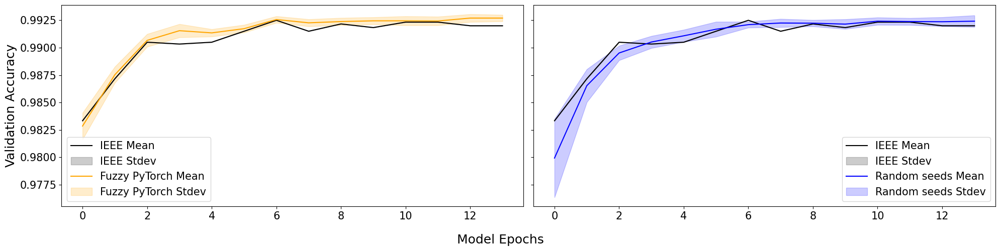

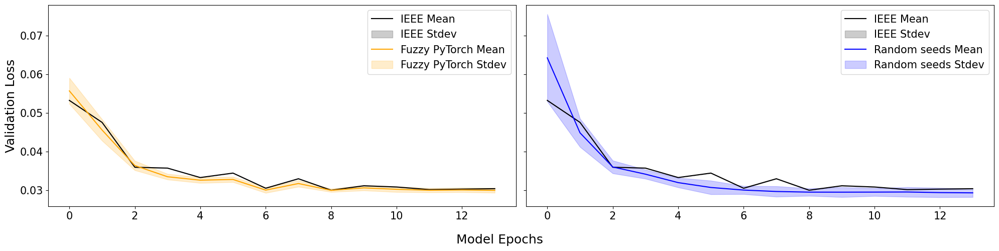

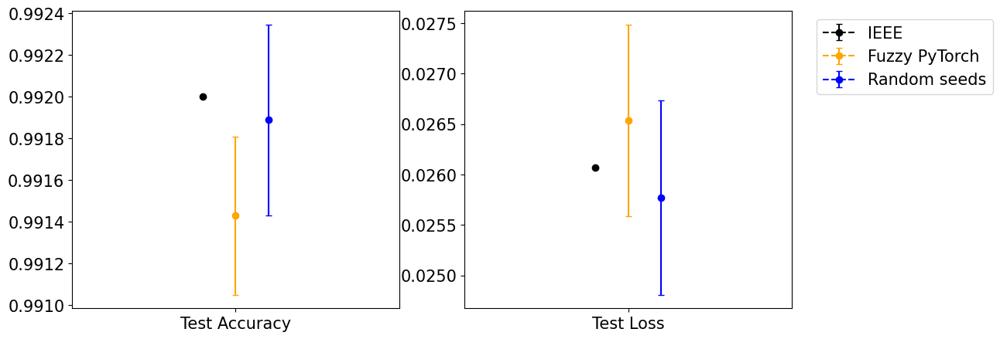

In [4]:
fig, axes = plt.subplots(1,2, sharey=True, figsize=(20, 5))
#IEEE
mean = ieee_val_accuracy.mean(axis=0)
stdev = ieee_val_accuracy.std(axis=0)
axes[0].plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
axes[0].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
axes[1].plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
axes[1].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
#Fuzzy SR
mean = sr_val_accuracy.mean(axis=0)
stdev = sr_val_accuracy.std(axis=0)
axes[0].plot(np.arange(len(mean)), mean, label='Fuzzy PyTorch Mean', color='orange')
axes[0].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Fuzzy PyTorch Stdev')
# #Fuzzy UD
# mean = ud_val_accuracy.mean(axis=0)
# stdev = ud_val_accuracy.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random
mean = random_val_accuracy.mean(axis=0)
stdev = random_val_accuracy.std(axis=0)
axes[1].plot(np.arange(len(mean)), mean, label='Random seeds Mean', color='blue')
axes[1].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Random seeds Stdev')
fig.supxlabel('Model Epochs', fontsize=18), axes[0].set_ylabel('Validation Accuracy',fontsize=18)
axes[0].legend(fontsize=15), axes[1].legend(fontsize=15)
axes[0].tick_params(axis='both', labelsize=15), axes[1].tick_params(axis='both', labelsize=15)
plt.tight_layout()
plt.savefig('/home/inesgp/cnn_training/figures/combo_val_accuracy.pdf', bbox_inches='tight')

fig, axes = plt.subplots(1,2, sharey=True, figsize=(20, 5))
#IEEE
mean = ieee_val_loss.mean(axis=0)
stdev = ieee_val_loss.std(axis=0)
axes[0].plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
axes[0].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
axes[1].plot(np.arange(len(mean)), mean, label='IEEE Mean', color='black')
axes[1].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='black', alpha=0.2, label='IEEE Stdev')
#Fuzzy SR
mean = sr_val_loss.mean(axis=0)
stdev = sr_val_loss.std(axis=0)
axes[0].plot(np.arange(len(mean)), mean, label='Fuzzy PyTorch Mean', color='orange')
axes[0].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Fuzzy PyTorch Stdev')
# #Fuzzy UD
# mean = ud_val_loss.mean(axis=0)
# stdev = ud_val_loss.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Fuzzy UD Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Fuzzy UD Stdev')
#Random
mean = random_val_loss.mean(axis=0)
stdev = random_val_loss.std(axis=0)
axes[1].plot(np.arange(len(mean)), mean, label='Random seeds Mean', color='blue')
axes[1].fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Random seeds Stdev')
fig.supxlabel('Model Epochs', fontsize=18), axes[0].set_ylabel('Validation Loss',fontsize=18)
axes[0].legend(fontsize=15), axes[1].legend(fontsize=15)
axes[0].tick_params(axis='both', labelsize=15), axes[1].tick_params(axis='both', labelsize=15)
plt.tight_layout()
plt.savefig('/home/inesgp/cnn_training/figures/combo_val_loss.pdf', bbox_inches='tight')


fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([0.99], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')
axes[0].errorbar([1], np.mean(sr_test_accuracy), yerr=np.std(sr_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Fuzzy PyTorch')
# axes[0].errorbar([1], np.mean(ud_test_accuracy), yerr=np.std(ud_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "green", color = "green", label='Fuzzy UD')
axes[0].errorbar([1.01], np.mean(random_test_accuracy), yerr=np.std(random_test_accuracy), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Random seeds')
axes[0].set_xticks([1], ['Test Accuracy'], fontsize=15) #, axes[0].legend()
axes[0].tick_params(axis='y', labelsize=15), axes[1].tick_params(axis='both', labelsize=15)
axes[0].set_xlim(0.95,1.05)

# plt.savefig('/home/inesgp/cnn_training/figures/randomseed_test_metrics.pdf',bbox_inches='tight');

axes[1].errorbar([0.99], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "black", color = "black", label='IEEE')
axes[1].errorbar([1], np.mean(sr_test_loss), yerr=np.std(sr_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "orange", color = "orange", label='Fuzzy PyTorch ')
# axes[1].errorbar([1], np.mean(ud_test_loss), yerr=np.std(ud_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "green", color = "green", label='Fuzzy UD')
axes[1].errorbar([1.01], np.mean(random_test_loss), yerr=np.std(random_test_loss), capsize=3, linestyle='--', marker='o', ecolor = "blue", color = "blue", label='Random seeds')
axes[1].set_xticks([1], ['Test Loss'], fontsize=15) #, axes[1].legend();
axes[1].tick_params(axis='y', labelsize=15), axes[1].tick_params(axis='both', labelsize=15)
axes[1].legend(fontsize=15, bbox_to_anchor=(1.05, 1), loc='upper left')
axes[1].set_xlim(0.95,1.05);
plt.savefig('/home/inesgp/cnn_training/figures/combo_test_metrics.pdf', bbox_inches='tight')



### Just IEEE

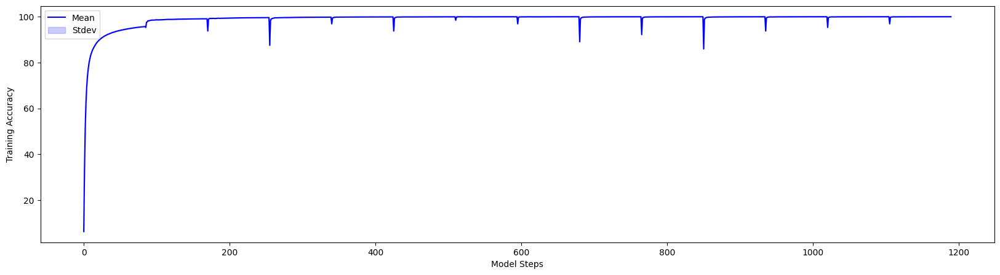

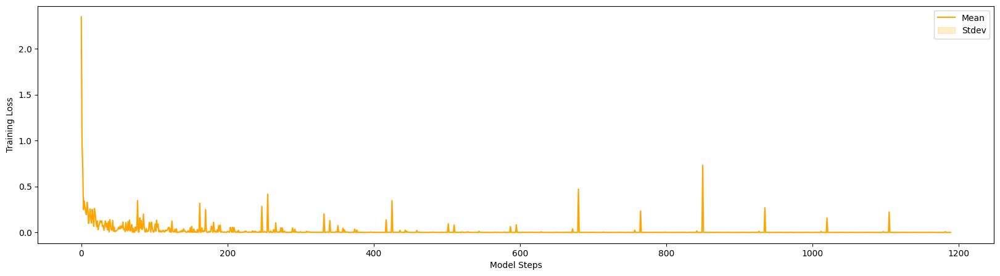

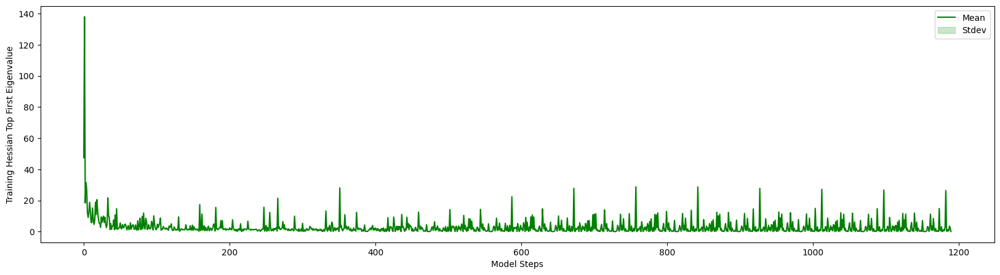

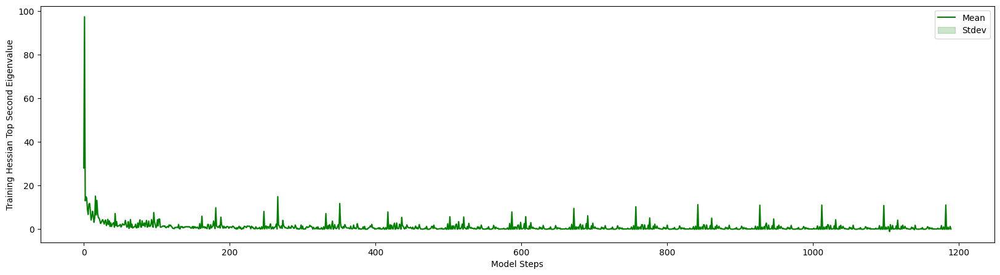

In [13]:
mean = ieee_train_accuracy.mean(axis=0)
stdev = ieee_train_accuracy.std(axis=0)
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Accuracy')
# plt.ylim(95,100)
plt.legend();

mean = ieee_train_loss.mean(axis=0)
stdev = ieee_train_loss.std(axis=0)
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Loss')
# plt.ylim(0,0.3)
plt.legend();

mean = ieee_hessian_1.mean(axis=0)
stdev = ieee_hessian_1.std(axis=0)
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Hessian Top First Eigenvalue')
# plt.ylim(0,0.3)
plt.legend();

mean = ieee_hessian_2.mean(axis=0)
stdev = ieee_hessian_2.std(axis=0)
plt.figure(figsize=(20, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Training Hessian Top Second Eigenvalue')
# plt.ylim(0,0.3)
plt.legend();

Accuracy coefficient of variation: 0.0
Loss coefficient of variation: nan


/tmp/ipykernel_2552339/1338862968.py:25: RuntimeWarning: invalid value encountered in scalar divide
  print(f"Loss coefficient of variation: {np.std(ieee_test_loss) / abs(np.mean(ieee_test_loss))}")


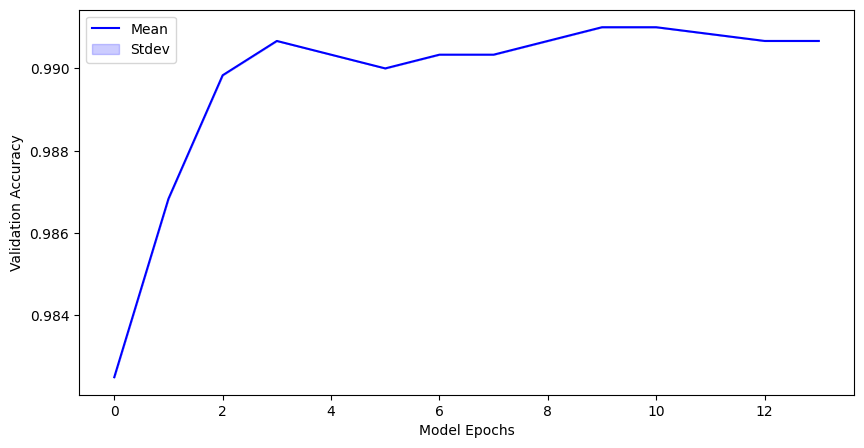

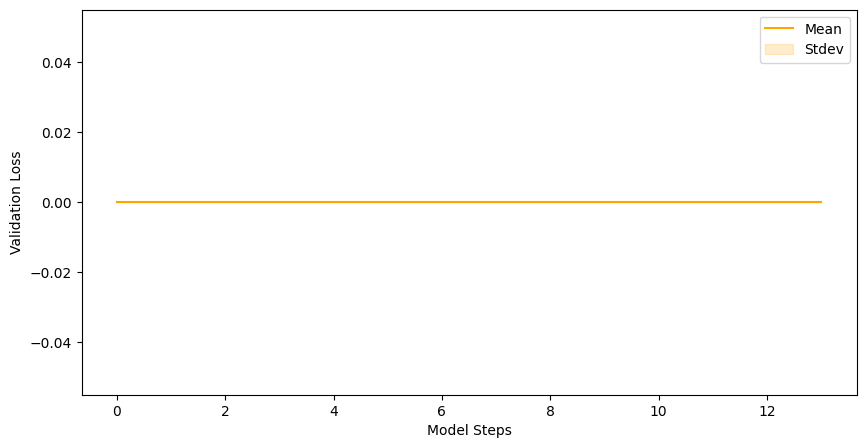

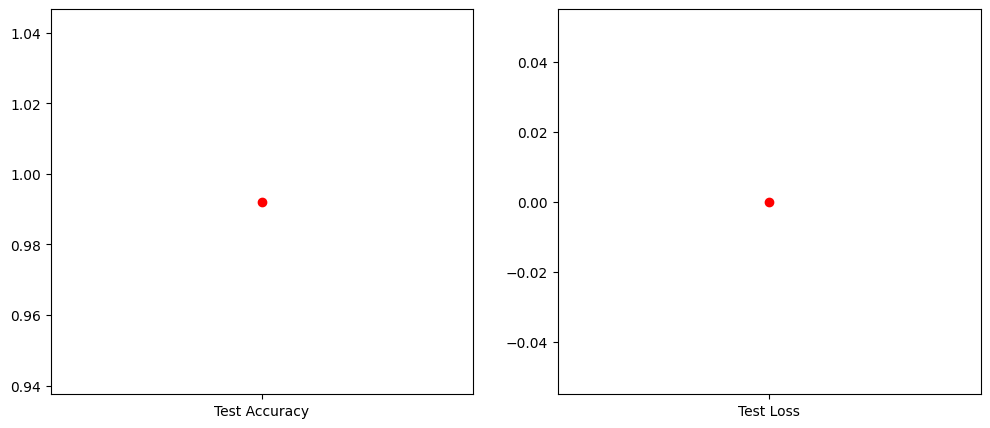

In [14]:
mean = ieee_val_accuracy.mean(axis=0)
stdev = ieee_val_accuracy.std(axis=0)
plt.figure(figsize=(10, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs'), plt.ylabel('Validation Accuracy')
plt.legend();

mean = ieee_val_loss.mean(axis=0)
stdev = ieee_val_loss.std(axis=0)
plt.figure(figsize=(10, 5))
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps'), plt.ylabel('Validation Loss')
# plt.ylim(0,0.3)
plt.legend();

fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black")
axes[0].set_xticks([1], ['Test Accuracy'])
axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt="r--o", ecolor = "black")
axes[1].set_xticks([1], ['Test Loss'])

print(f"Accuracy coefficient of variation: {np.std(ieee_test_accuracy) / abs(np.mean(ieee_test_accuracy))}")
print(f"Loss coefficient of variation: {np.std(ieee_test_loss) / abs(np.mean(ieee_test_loss))}")

### Random Seed Training

In [6]:
# train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy, hessian_1, hessian_2 = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_mnist_train', hessian=True)
train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='randomseed_v2_mnist_train', hessian=False, iter=11, filetype='log')

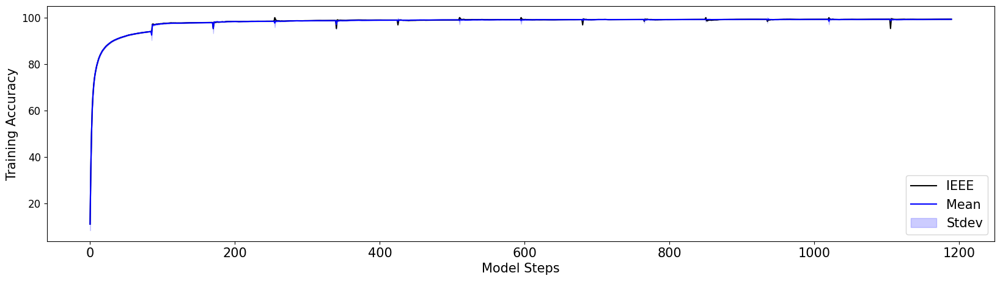

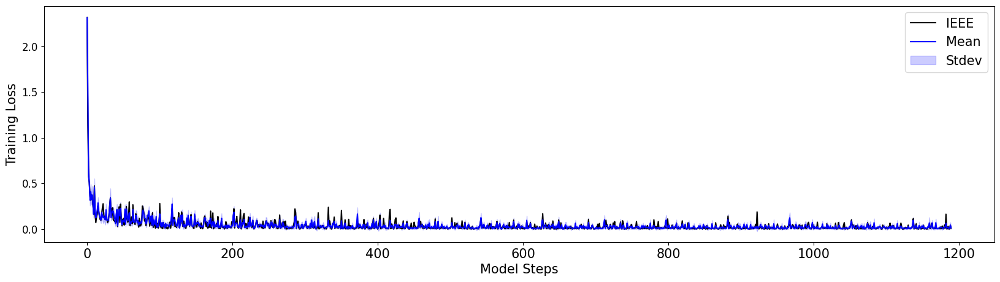

In [7]:
plt.figure(figsize=(20, 5))
mean = ieee_train_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black', )
mean = train_accuracy.mean(axis=0)
stdev = train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15)
plt.savefig('/home/inesgp/cnn_training/figures/randomseed_training_accuracy.pdf',bbox_inches='tight');

plt.figure(figsize=(20, 5))
mean = ieee_train_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = train_loss.mean(axis=0)
stdev = train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15)
plt.savefig('/home/inesgp/cnn_training/figures/randomseed_training_loss.pdf', bbox_inches='tight');

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_1.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_1.mean(axis=0)
# stdev = hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top First Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_2.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_2.mean(axis=0)
# stdev = hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top Second Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

/tmp/ipykernel_2851002/3597167649.py:28: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
/tmp/ipykernel_2851002/3597167649.py:29: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
/tmp/ipykernel_2851002/3597167649.py:36: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt

Accuracy coefficient of variation: 0.000267642413682673
Loss coefficient of variation: nan


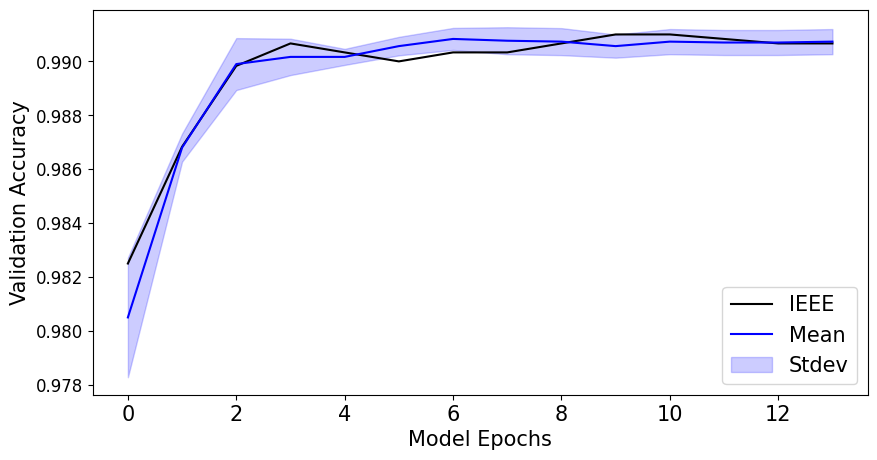

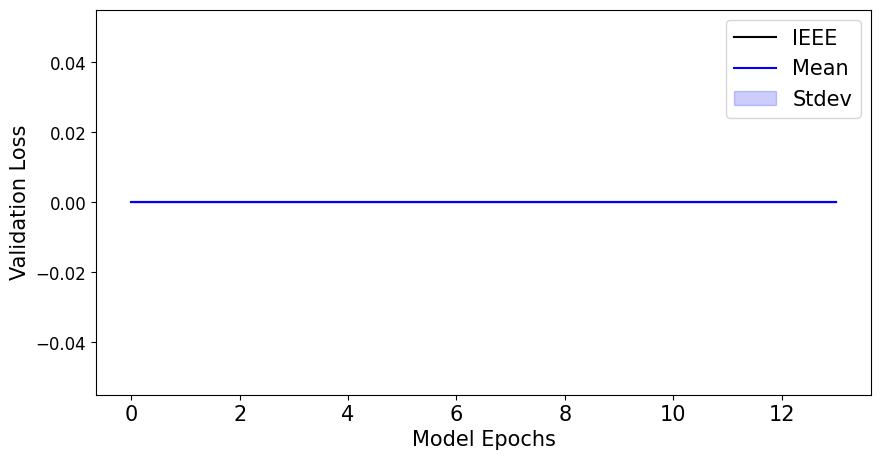

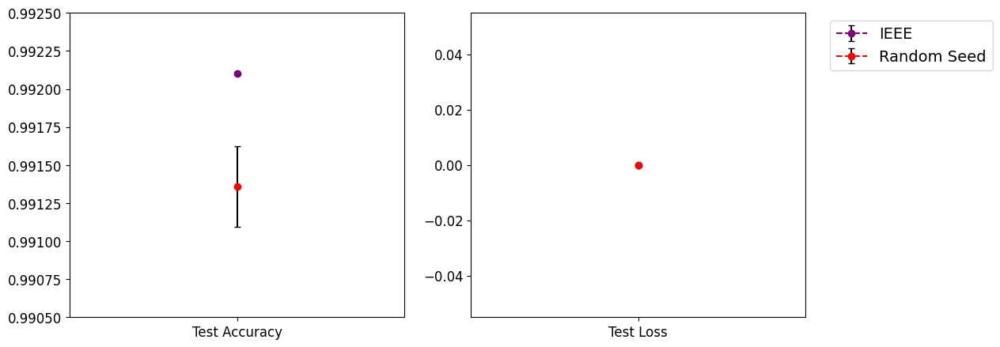

In [6]:
plt.figure(figsize=(10, 5))
mean = ieee_val_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_accuracy.mean(axis=0)
stdev = val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
plt.savefig('/home/inesgp/cnn_training/figures/randomseed_val_accuracy.pdf',bbox_inches='tight');



plt.figure(figsize=(10, 5))
mean = ieee_val_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_loss.mean(axis=0)
stdev = val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='blue')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='blue', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
plt.savefig('/home/inesgp/cnn_training/figures/randomseed_val_loss.pdf',bbox_inches='tight');

fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
axes[0].set_xticks([1], ['Test Accuracy'], fontsize=12), 
axes[0].tick_params(axis='both', labelsize=12)  
axes[0].set_ylim(0.9905,0.9925)
# axes[0].legend(fontsize=14)


axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[1].errorbar([1], np.mean(test_loss), yerr=np.std(test_loss), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
axes[1].set_xticks([1], ['Test Loss'], fontsize=12), 
axes[1].tick_params(axis='both', labelsize=12)  
axes[1].legend(fontsize=14, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('/home/inesgp/cnn_training/figures/randomseed_test_metrics.pdf',bbox_inches='tight');

print(f"Accuracy coefficient of variation: {np.std(test_accuracy) / abs(np.mean(test_accuracy))}")
print(f"Loss coefficient of variation: {np.std(test_loss) / abs(np.mean(test_loss))}")

### Fuzzy Training -- need to retrain to obtain Hessian values

In [8]:
# train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy = process_log(dir='/home/inesgp/mnist/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False)
train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy = process_log(dir='/home/inesgp/cnn_training/slurm', filename='fuzzy_mnist_train_sr', iter=11, hessian=False, filetype='log')


In [24]:
train_loss_all = []
val_loss_all = []
test_loss_all = []
train_acc_all = []
val_acc_all = []
test_acc_all = []

for i in range(1, 6):
    train_loss, val_loss, test_loss, train_accuracy, val_accuracy, test_accuracy = process_log(
        dir='/home/inesgp/mnist/slurm', 
        filename=f'fuzzy_sr_seed_{i}', 
        iter=11, 
        hessian=False,
        filetype='log'
    )
    train_loss_all.append(train_loss)
    val_loss_all.append(val_loss)
    test_loss_all.append(test_loss)
    train_acc_all.append(train_accuracy)
    val_acc_all.append(val_accuracy)
    test_acc_all.append(test_accuracy)

train_loss_all = np.concatenate(train_loss_all)
val_loss_all = np.concatenate(val_loss_all)
test_loss_all = np.concatenate(test_loss_all)
train_acc_all = np.concatenate(train_acc_all)
val_acc_all = np.concatenate(val_acc_all)
test_acc_all = np.concatenate(test_acc_all)

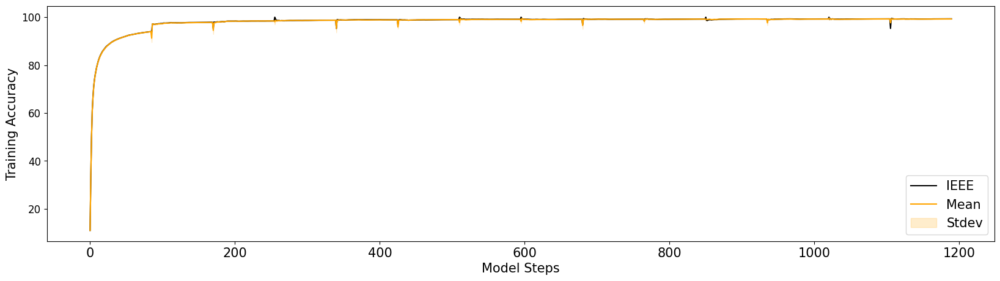

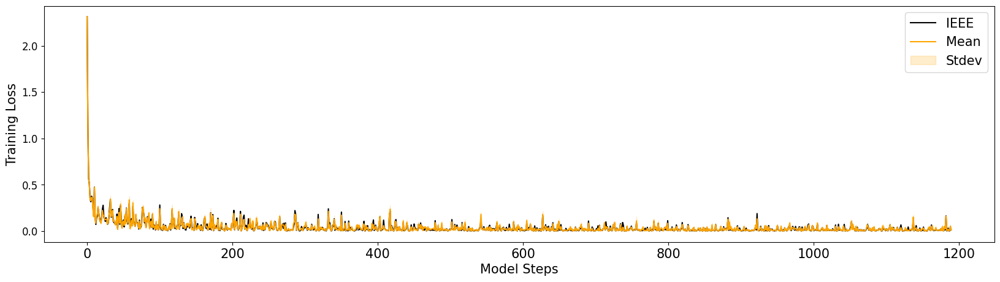

In [9]:
plt.figure(figsize=(20, 5))
mean = ieee_train_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black', )
mean = train_accuracy.mean(axis=0)
stdev = train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_training_accuracy.pdf',bbox_inches='tight');

plt.figure(figsize=(20, 5))
mean = ieee_train_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = train_loss.mean(axis=0)
stdev = train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_training_loss.pdf',bbox_inches='tight');

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_1.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_1.mean(axis=0)
# stdev = hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top First Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_2.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_2.mean(axis=0)
# stdev = hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top Second Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

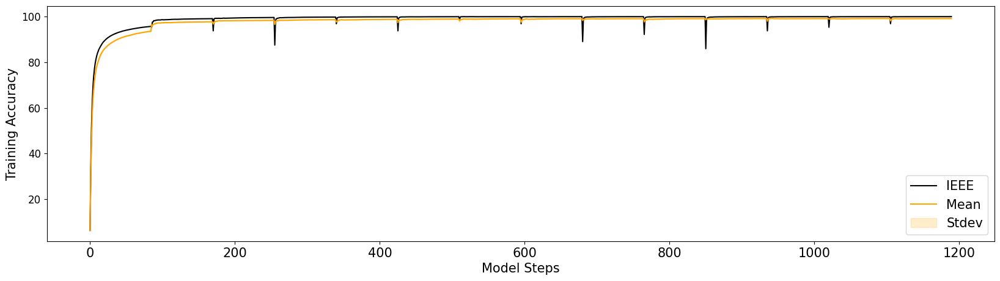

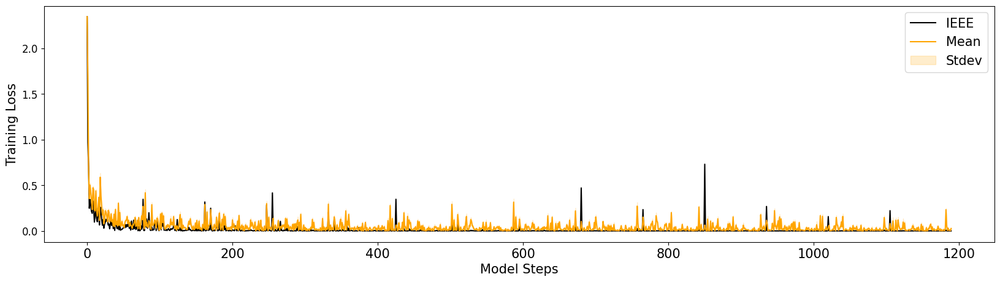

In [8]:
plt.figure(figsize=(20, 5))
mean = ieee_train_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black', )
mean = train_accuracy.mean(axis=0)
stdev = train_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange', )
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_training_accuracy.pdf',bbox_inches='tight');

plt.figure(figsize=(20, 5))
mean = ieee_train_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = train_loss.mean(axis=0)
stdev = train_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_training_loss.pdf',bbox_inches='tight');

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_1.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_1.mean(axis=0)
# stdev = hessian_1.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top First Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

# plt.figure(figsize=(20, 5))
# mean = ieee_hessian_2.mean(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
# mean = hessian_2.mean(axis=0)
# stdev = hessian_2.std(axis=0)
# plt.plot(np.arange(len(mean)), mean, label='Mean', color='green')
# plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='green', alpha=0.2, label='Stdev')
# plt.xlabel('Model Steps', fontsize=15), plt.ylabel('Training Hessian Top Second Eigenvalue', fontsize=15)
# plt.xticks(fontsize=15), plt.yticks(fontsize=12)
# plt.legend(fontsize=15);

Accuracy coefficient of variation: 0.0003978914830502109
Loss coefficient of variation: 0.035231701955423446


/tmp/ipykernel_2879628/1456918235.py:28: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
/tmp/ipykernel_2879628/1456918235.py:29: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
/tmp/ipykernel_2879628/1456918235.py:36: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt

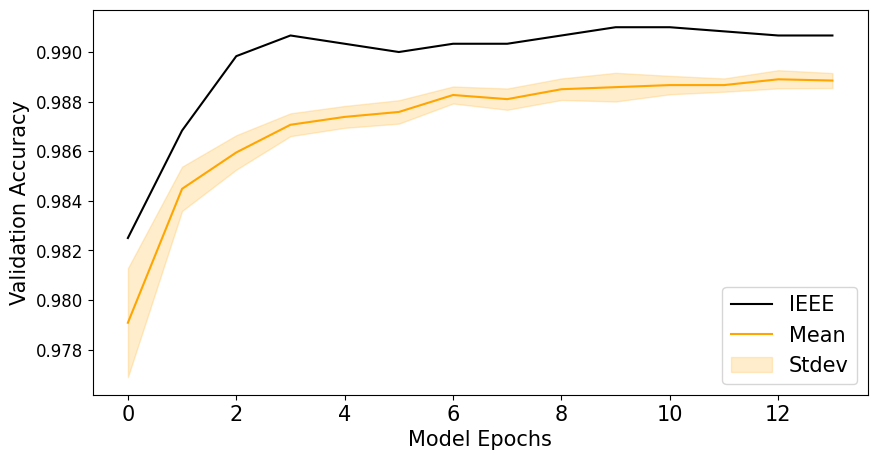

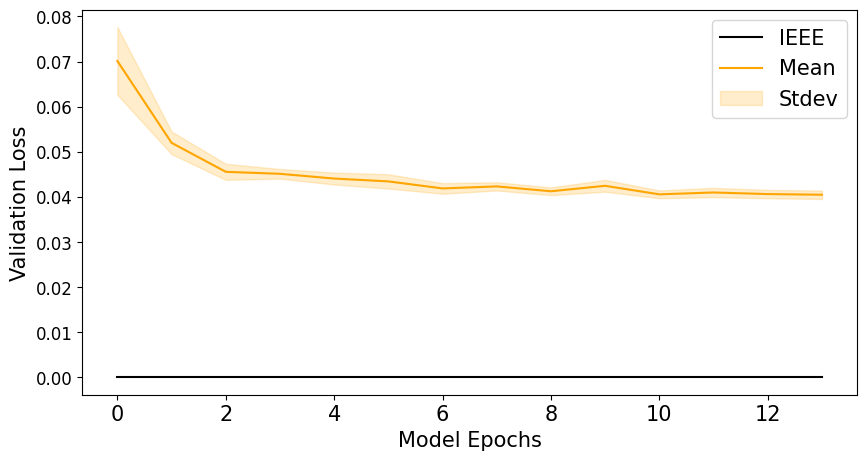

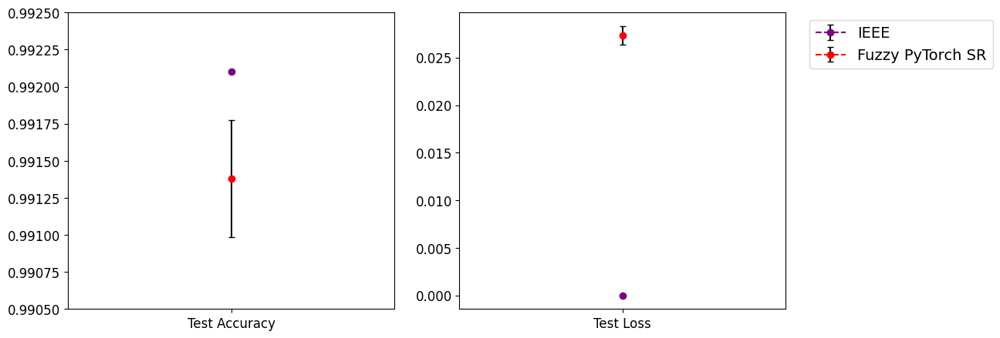

In [26]:
plt.figure(figsize=(10, 5))
mean = ieee_val_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_accuracy.mean(axis=0)
stdev = val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_val_accuracy.pdf',bbox_inches='tight');


plt.figure(figsize=(10, 5))
mean = ieee_val_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_loss.mean(axis=0)
stdev = val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_val_loss.pdf',bbox_inches='tight');


fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
axes[0].set_xticks([1], ['Test Accuracy'], fontsize=12), 
axes[0].tick_params(axis='both', labelsize=12)  
axes[0].set_ylim(0.9905,0.9925)
# axes[0].legend(fontsize=14)


axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[1].errorbar([1], np.mean(test_loss), yerr=np.std(test_loss), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Fuzzy PyTorch SR')
axes[1].set_xticks([1], ['Test Loss'], fontsize=12), 
axes[1].tick_params(axis='both', labelsize=12)  
axes[1].legend(fontsize=14, bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_test_metrics.pdf',bbox_inches='tight');

print(f"Accuracy coefficient of variation: {np.std(test_accuracy) / abs(np.mean(test_accuracy))}")
print(f"Loss coefficient of variation: {np.std(test_loss) / abs(np.mean(test_loss))}")

/tmp/ipykernel_2851002/1193743323.py:28: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
/tmp/ipykernel_2851002/1193743323.py:29: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
/tmp/ipykernel_2851002/1193743323.py:36: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r--o" (-> color='r'). The keyword argument will take precedence.
  axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt

Accuracy coefficient of variation: 0.0002931433453005576
Loss coefficient of variation: 0.020458596061176


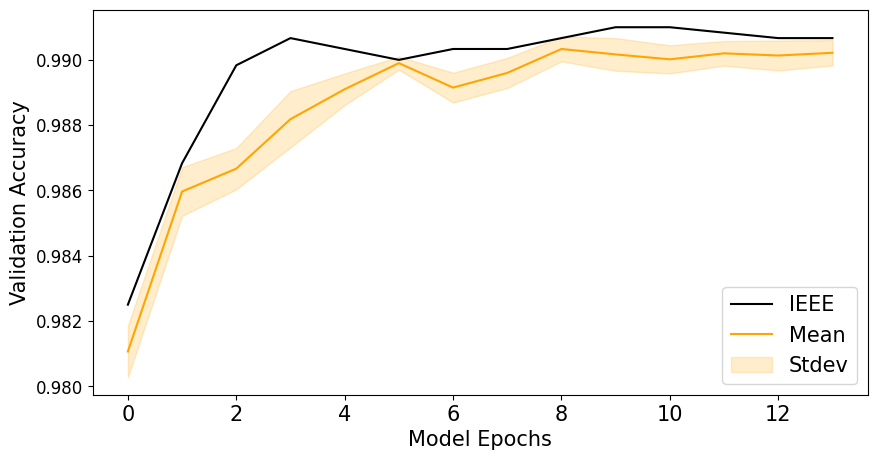

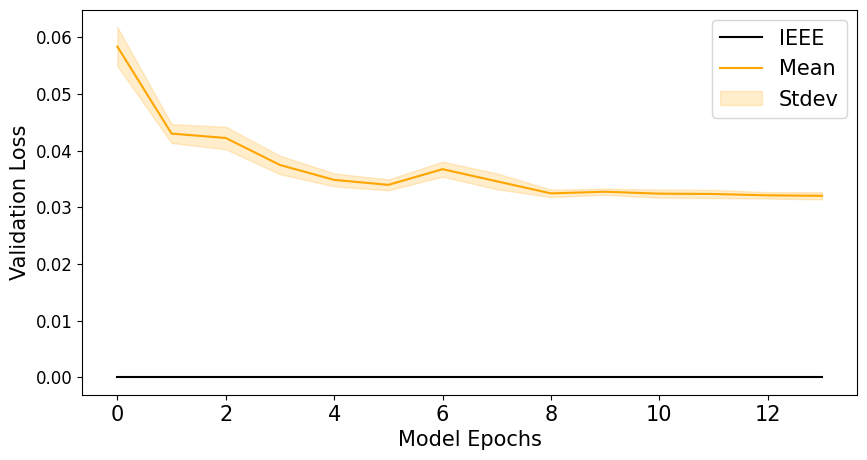

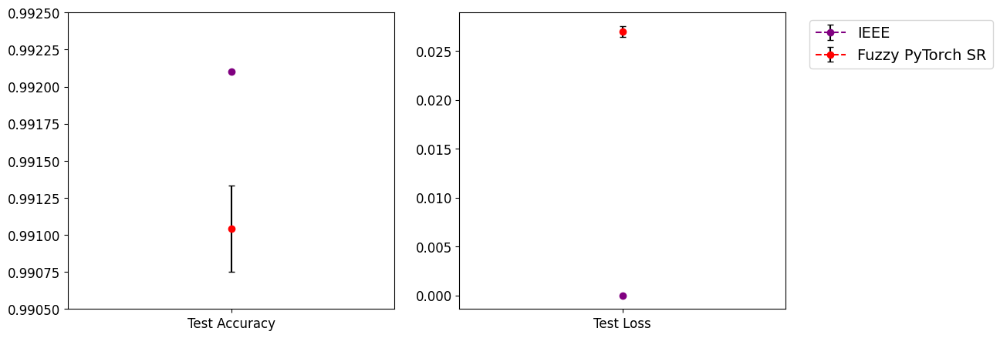

In [9]:
plt.figure(figsize=(10, 5))
mean = ieee_val_accuracy.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_accuracy.mean(axis=0)
stdev = val_accuracy.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Accuracy', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_val_accuracy.pdf',bbox_inches='tight');


plt.figure(figsize=(10, 5))
mean = ieee_val_loss.mean(axis=0)
plt.plot(np.arange(len(mean)), mean, label='IEEE', color='black')
mean = val_loss.mean(axis=0)
stdev = val_loss.std(axis=0)
plt.plot(np.arange(len(mean)), mean, label='Mean', color='orange')
plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, color='orange', alpha=0.2, label='Stdev')
plt.xlabel('Model Epochs', fontsize=15), plt.ylabel('Validation Loss', fontsize=15)
plt.xticks(fontsize=15), plt.yticks(fontsize=12)
plt.legend(fontsize=15);
plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_val_loss.pdf',bbox_inches='tight');


fig, axes = plt.subplots(1,2, figsize=(12,5))
axes[0].errorbar([1], np.mean(ieee_test_accuracy), yerr=np.std(ieee_test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[0].errorbar([1], np.mean(test_accuracy), yerr=np.std(test_accuracy), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Random Seed')
axes[0].set_xticks([1], ['Test Accuracy'], fontsize=12), 
axes[0].tick_params(axis='both', labelsize=12)  
axes[0].set_ylim(0.9905,0.9925)
# axes[0].legend(fontsize=14)


axes[1].errorbar([1], np.mean(ieee_test_loss), yerr=np.std(ieee_test_loss), capsize=3, fmt="r--o", ecolor = "black", color='purple', label='IEEE')
axes[1].errorbar([1], np.mean(test_loss), yerr=np.std(test_loss), capsize=3, fmt="r--o", ecolor = "black", color='red', label='Fuzzy PyTorch SR')
axes[1].set_xticks([1], ['Test Loss'], fontsize=12), 
axes[1].tick_params(axis='both', labelsize=12)  
axes[1].legend(fontsize=14, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('/home/inesgp/cnn_training/figures/fuzzy_sr_test_metrics.pdf',bbox_inches='tight');

print(f"Accuracy coefficient of variation: {np.std(test_accuracy) / abs(np.mean(test_accuracy))}")
print(f"Loss coefficient of variation: {np.std(test_loss) / abs(np.mean(test_loss))}")

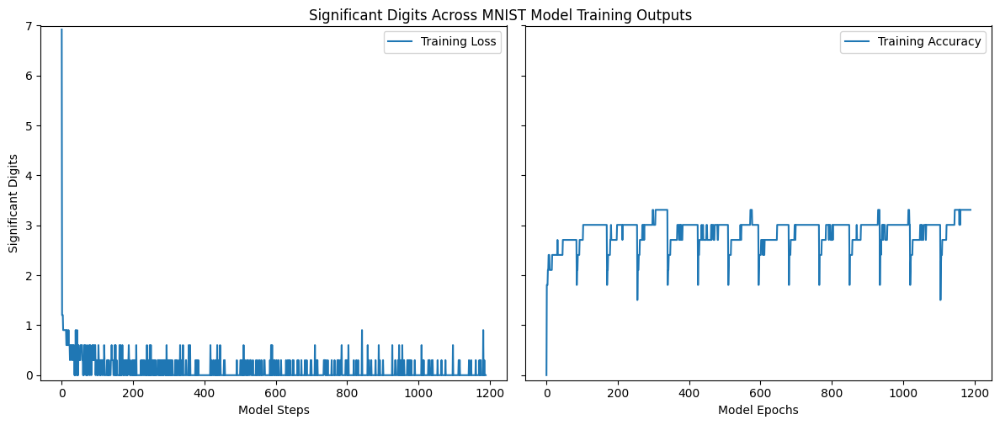

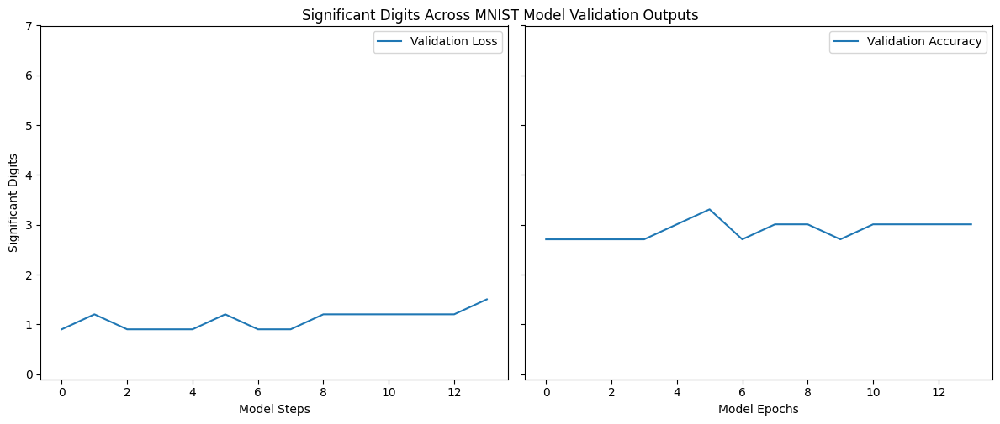

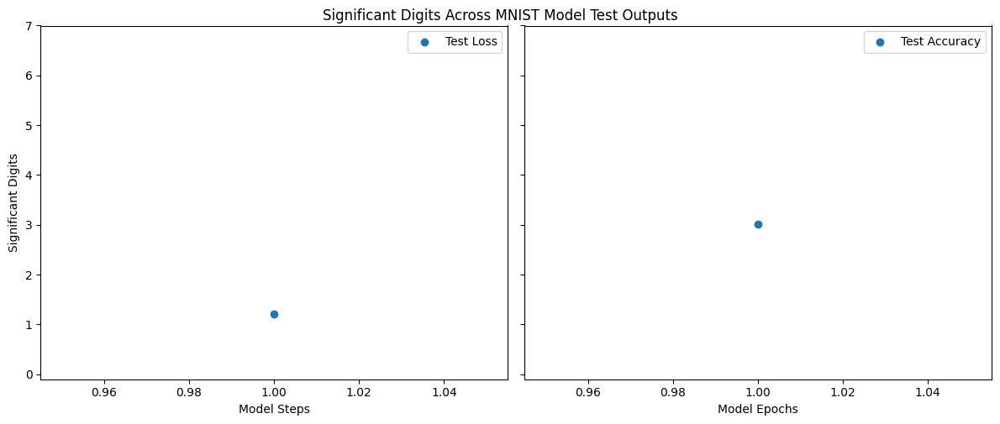

In [49]:
acc_sig = sd.significant_digits(train_accuracy.astype(dtype=np.float32), reference=train_accuracy.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)
loss_sig = sd.significant_digits(train_loss.astype(dtype=np.float32), reference=train_loss.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)

fig, axes = plt.subplots(1,2, figsize=(12,5), sharey=True)
axes[0].plot(loss_sig, label='Training Loss')
axes[0].set_xlabel('Model Steps'), axes[0].set_ylabel('Significant Digits')
axes[0].legend(), axes[0].set_ylim(-0.1,7)
axes[1].plot(acc_sig, label='Training Accuracy')
axes[1].set_xlabel('Model Epochs')
axes[1].legend(), axes[1].set_ylim(-0.1,7)
plt.tight_layout()
fig.suptitle('Significant Digits Across MNIST Model Training Outputs', y=1);

acc_sig = sd.significant_digits(val_accuracy.astype(dtype=np.float32), reference=val_accuracy.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)
loss_sig = sd.significant_digits(val_loss.astype(dtype=np.float32), reference=val_loss.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)

fig, axes = plt.subplots(1,2, figsize=(12,5), sharey=True)
axes[0].plot(loss_sig, label='Validation Loss')
axes[0].set_xlabel('Model Steps'), axes[0].set_ylabel('Significant Digits')
axes[0].legend(), axes[0].set_ylim(-0.1,7)
axes[1].plot(acc_sig, label='Validation Accuracy')
axes[1].set_xlabel('Model Epochs')
axes[1].legend(), axes[1].set_ylim(-0.1,7)
plt.tight_layout()
fig.suptitle('Significant Digits Across MNIST Model Validation Outputs', y=1);

acc_sig = sd.significant_digits(test_accuracy.astype(dtype=np.float32), reference=test_accuracy.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)
loss_sig = sd.significant_digits(test_loss.astype(dtype=np.float32), reference=test_loss.mean(axis=0, dtype=np.float32),  basis=10, error=Error.Relative, method=Method.General)

fig, axes = plt.subplots(1,2, figsize=(12,5), sharey=True)
axes[0].scatter([1], loss_sig, label='Test Loss')
axes[0].set_xlabel('Model Steps'), axes[0].set_ylabel('Significant Digits')
axes[0].legend(), axes[0].set_ylim(-0.1,7)
axes[1].scatter([1], acc_sig, label='Test Accuracy')
axes[1].set_xlabel('Model Epochs')
axes[1].legend(), axes[1].set_ylim(-0.1,7)
plt.tight_layout()
fig.suptitle('Significant Digits Across MNIST Model Test Outputs', y=1);

## Model Weights

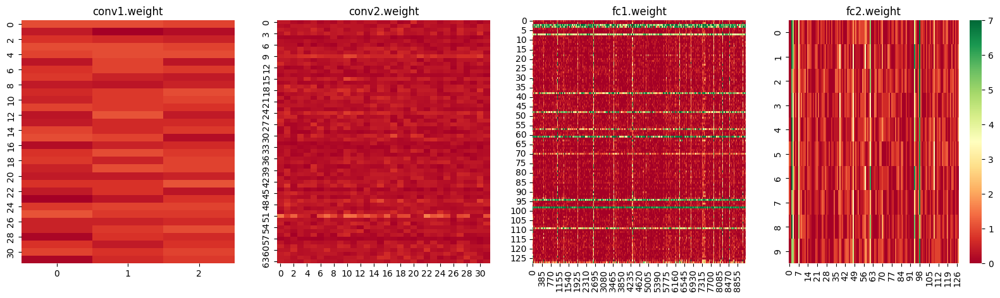

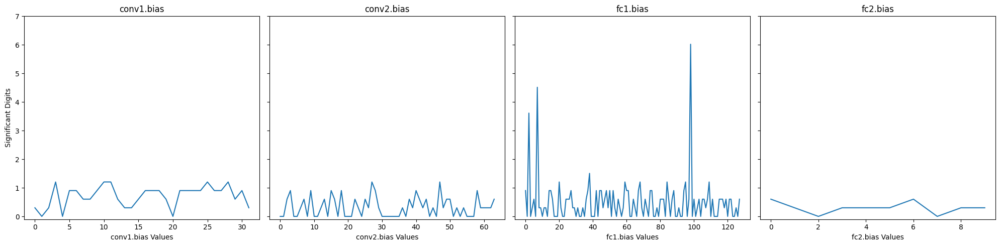

In [105]:
DIR = '/home/inesgp/mnist/'

weights = {'conv1.weight': [], 'conv1.bias': [], 'conv2.weight': [], 'conv2.bias': [], 'fc1.weight': [], 'fc1.bias': [], 'fc2.weight': [], 'fc2.bias': []}

for i in range(1,6):
    model = torch.load(f"{DIR}/fuzzy_mnist_cnn_{i}.pt")
    for layer in weights.keys():
        weights[layer].append( model[layer])


# #weights
_, axes = plt.subplots(1,4, figsize=(20,5))
for num, layer in enumerate(['conv1.weight', 'conv2.weight', 'fc1.weight', 'fc2.weight']):
    weights[layer] = torch.stack(weights[layer])
    # print( weights[layer].shape )
    # print(weights[layer].std(dim=0).squeeze().shape)

    layer_sig = sd.significant_digits(weights[layer], reference=weights[layer].mean(dim=0),  basis=10, error=Error.Relative, method=Method.General).squeeze()
    # print(layer_sig.shape)


    if 'conv1' in layer:
        sns.heatmap(layer_sig.mean(axis=-1), cmap='RdYlGn', ax=axes[num], vmax=7, cbar=False)
    elif 'conv2' in layer:
        sns.heatmap(layer_sig.mean(axis=-1).mean(axis=-1), cmap='RdYlGn', ax=axes[num], vmax=7, cbar=False)
    elif 'fc1' in layer:
        sns.heatmap(layer_sig, cmap='RdYlGn', ax=axes[num], vmax=7, cbar=False)
    elif 'fc2' in layer:
        sns.heatmap(layer_sig, cmap='RdYlGn', ax=axes[num], vmax=7, cbar=True)

    axes[num].set_title(layer)


#bias
_, axes = plt.subplots(1,4, figsize=(20,5), sharey=True)
for num, layer in enumerate(['conv1.bias', 'conv2.bias', 'fc1.bias', 'fc2.bias']):
    weights[layer] = torch.stack(weights[layer])
    # print( weights[layer].shape )

    layer_sig = sd.significant_digits(weights[layer], reference=weights[layer].mean(dim=0),  basis=10, error=Error.Relative, method=Method.General).squeeze()
    
    axes[num].plot(layer_sig, label=layer)
    axes[num].set_ylim(-0.1,7)
    axes[num].set_xlabel(f'{layer} Values')
    axes[num].set_title(layer)

axes[0].set_ylabel('Significant Digits')
fig.legend()
plt.tight_layout();


**Frobenius/L2 general weight norms**

In [78]:
# Function to compute pairwise norms
pairwise_diffs = {}

for layer_name, w in weights.items():
    n_models = w.shape[0]
    diffs = torch.zeros((n_models, n_models))
    
    for i, j in itertools.combinations(range(n_models), 2):
        # norm = torch.linalg.matrix_norm(w[i] - w[j], 'fro')  # Frobenius (L2) norm
        norm = torch.norm(w[i] - w[j], p='fro')  # Frobenius (L2) norm
        diffs[i, j] = norm
        diffs[j, i] = norm  # symmetric

    pairwise_diffs[layer_name] = diffs
    # pairwise_diffs[layer_name] = pairwise_diffs[layer_name][torch.triu_indices(5, 5, offset=1).unbind()]


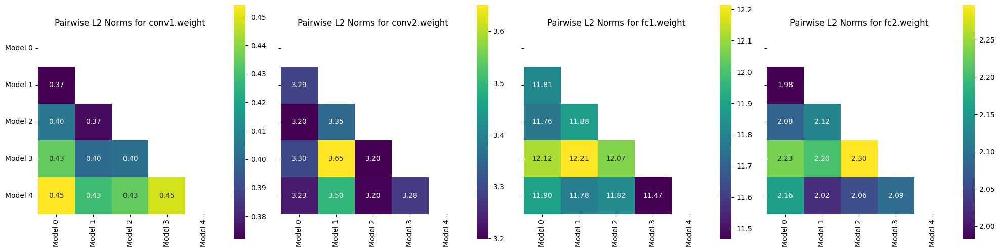

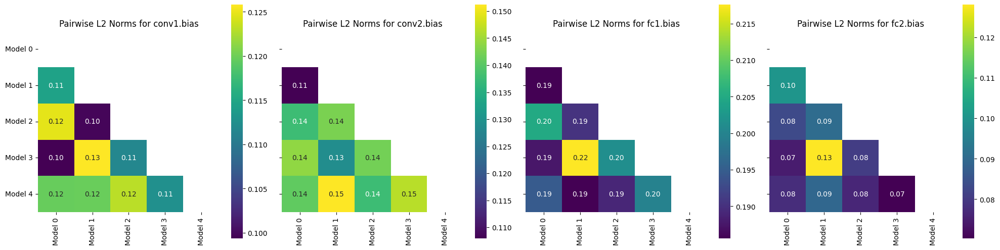

In [96]:
#weights
_, axes = plt.subplots(1,4, figsize=(20,5), sharey=True)
for num, layer_name in enumerate(['conv1.weight', 'conv2.weight', 'fc1.weight', 'fc2.weight']):

    matrix = pairwise_diffs[layer_name]

    n = matrix.shape[0]

    # Create a boolean mask for the upper triangle
    mask = np.triu(np.ones((n, n), dtype=bool))

    sns.heatmap(matrix.numpy(), mask=mask, annot=True, fmt=".2f", cmap='viridis', square=True, ax=axes[num],
                xticklabels=[f"Model {i}" for i in range(matrix.shape[0])],
                yticklabels=[f"Model {i}" for i in range(matrix.shape[0])])
    axes[num].set_title(f"Pairwise L2 Norms for {layer_name}")
plt.tight_layout()


#bias
_, axes = plt.subplots(1,4, figsize=(20,5), sharey=True)
for num, layer_name in enumerate(['conv1.bias', 'conv2.bias', 'fc1.bias', 'fc2.bias']):

    matrix = pairwise_diffs[layer_name]

    n = matrix.shape[0]

    # Create a boolean mask for the upper triangle
    mask = np.triu(np.ones((n, n), dtype=bool))

    sns.heatmap(matrix.numpy(), mask=mask, annot=True, fmt=".2f", cmap='viridis', square=True, ax=axes[num],
                xticklabels=[f"Model {i}" for i in range(matrix.shape[0])],
                yticklabels=[f"Model {i}" for i in range(matrix.shape[0])])
    axes[num].set_title(f"Pairwise L2 Norms for {layer_name}")
plt.tight_layout();


**CKA Similarity**

In [98]:
def flatten_activations(act):
    return act.view(act.shape[0], -1)

def center_gram(gram):
    n = gram.size(0)
    identity = torch.eye(n, device=gram.device)
    ones = torch.ones((n, n), device=gram.device) / n
    return gram - ones @ gram - gram @ ones + ones @ gram @ ones

def linear_CKA(X, Y):
    # X, Y: [n_samples, n_features]
    X = X - X.mean(0)
    Y = Y - Y.mean(0)

    gram_X = X @ X.T
    gram_Y = Y @ Y.T

    gram_X_centered = center_gram(gram_X)
    gram_Y_centered = center_gram(gram_Y)

    hsic = (gram_X_centered * gram_Y_centered).sum()
    norm_X = torch.norm(gram_X_centered)
    norm_Y = torch.norm(gram_Y_centered)

    return hsic / (norm_X * norm_Y)


cka_sims = {}

n_models = 5
for num, layer_name in enumerate(weights.keys()):

    similarities = np.zeros((n_models, n_models))

    for i, j in itertools.combinations(range(n_models), 2):

        act1 = flatten_activations(weights[layer_name][i])
        act2 = flatten_activations(weights[layer_name][j])

        cka_score = linear_CKA(act1, act2)
        similarities[i,j] = cka_score
        similarities[j,i] = cka_score
    #     print(f"CKA similarity between {i} and {j} ({layer_name}): {cka_score.item():.4f}")
    # print()

    cka_sims[layer_name] = similarities
    

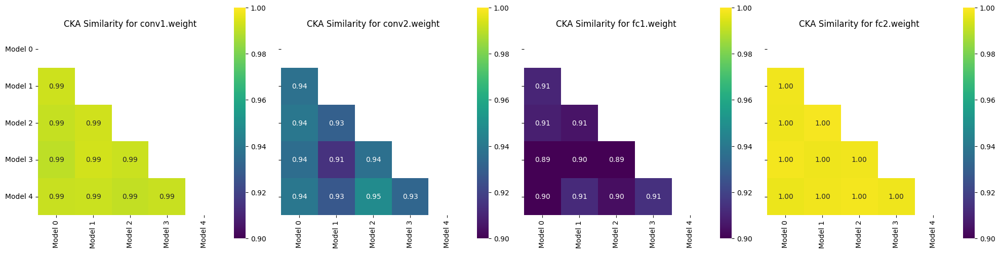

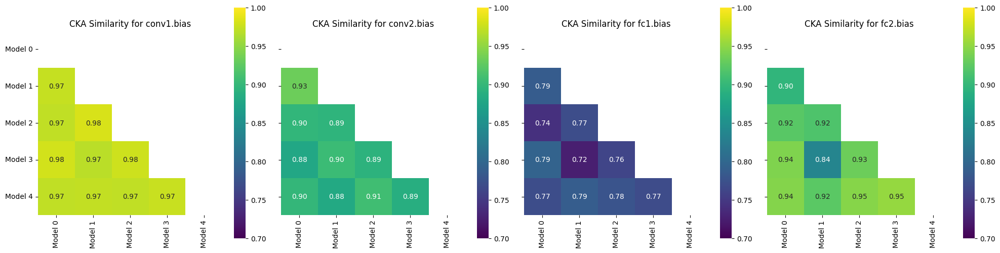

In [103]:
#weights
_, axes = plt.subplots(1,4, figsize=(20,5), sharey=True)
for num, layer_name in enumerate(['conv1.weight', 'conv2.weight', 'fc1.weight', 'fc2.weight']):

    matrix = cka_sims[layer_name]

    n = matrix.shape[0]

    # Create a boolean mask for the upper triangle
    mask = np.triu(np.ones((n, n), dtype=bool))

    sns.heatmap(matrix, mask=mask, annot=True, fmt=".2f", cmap='viridis', square=True, ax=axes[num], vmax=1, vmin=0.9,
                xticklabels=[f"Model {i}" for i in range(matrix.shape[0])],
                yticklabels=[f"Model {i}" for i in range(matrix.shape[0])])
    axes[num].set_title(f"CKA Similarity for {layer_name}")
plt.tight_layout()


#bias
_, axes = plt.subplots(1,4, figsize=(20,5), sharey=True)
for num, layer_name in enumerate(['conv1.bias', 'conv2.bias', 'fc1.bias', 'fc2.bias']):

    matrix = cka_sims[layer_name]

    n = matrix.shape[0]

    # Create a boolean mask for the upper triangle
    mask = np.triu(np.ones((n, n), dtype=bool))

    sns.heatmap(matrix, mask=mask, annot=True, fmt=".2f", cmap='viridis', square=True, ax=axes[num], vmax=1, vmin=0.7,
                xticklabels=[f"Model {i}" for i in range(matrix.shape[0])],
                yticklabels=[f"Model {i}" for i in range(matrix.shape[0])])
    axes[num].set_title(f"CKA Similarity for {layer_name}")
plt.tight_layout()

## Loss Landscape

In [2]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, 3, 1, bias=True)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, bias=True)
        self.dropout1 = nn.Dropout(0.25)
        self.dropout2 = nn.Dropout(0.5)
        self.fc1 = nn.Linear(9216, 128)
        self.fc2 = nn.Linear(128, 10)

    def forward(self, x):
        x = self.conv1(x)
        x = F.relu(x)
        x = self.conv2(x)
        x = F.relu(x)
        x = F.max_pool2d(x, 2)
        x = self.dropout1(x)
        x = torch.flatten(x, 1)
        x = self.fc1(x)
        x = F.relu(x)
        x = self.dropout2(x)
        x = self.fc2(x)
        output = F.log_softmax(x, dim=1)
        return output

train_kwargs = {'batch_size': 64}
test_kwargs = {'batch_size': 1000}
lr = 1.0
gamma = 0.7

transform=transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.1307,), (0.3081,))
        ])

# dataset1 = datasets.MNIST('./data', train=True, download=True,
#                     transform=transform)
dataset2 = datasets.MNIST('/home/inesgp/mnist/data', train=False,
                    transform=transform)
# train_loader = torch.utils.data.DataLoader(dataset1,**train_kwargs)
test_loader = torch.utils.data.DataLoader(dataset2, **test_kwargs)

model = Net()
model.load_state_dict(torch.load(f"/home/inesgp/mnist/fuzzy_mnist_cnn_1.pt"))

optimizer = optim.Adadelta(model.parameters(), lr=lr)

scheduler = StepLR(optimizer, step_size=1, gamma=gamma)
criterion = nn.NLLLoss()


Each eigenvalue of the Hessian represents the curvature of the loss in a specific direction in parameter space:

* Large positive eigenvalues \
→ Sharp curvature (steep valley) in that direction \
→ The optimizer might overshoot or become unstable if the learning rate is too high. 

* Small positive eigenvalues (close to zero) \
→ Flat or nearly flat directions \
→ The model may converge slowly along these directions. 

* Negative eigenvalues \
→ Indicates the presence of saddle points or local maxima \
→ The model is not at a local minimum, and gradients may be misleading. \

In [3]:
from pyhessian import hessian

# Get a batch of data
dataiter = iter(test_loader)
inputs, targets = next(dataiter)

# Ensure model is in evaluation mode
model.eval()

# Compute the Hessian
hessian_comp = hessian(model, criterion, data=(inputs, targets), cuda=torch.cuda.is_available())

# Get top eigenvalues
top_eigenvalues, _ = hessian_comp.eigenvalues()
print("Top Hessian Eigenvalues:", top_eigenvalues)


/home/inesgp/.local/lib/python3.11/site-packages/torch/autograd/graph.py:824: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid this. If you have to use this function, make sure to reset the .grad fields of your parameters to None after use to break the cycle and avoid the leak. (Triggered internally at /pytorch/torch/csrc/autograd/engine.cpp:1273.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Top Hessian Eigenvalues: [2.8819503784179688]


**Trace of the Hessian**\
Definition: Sum of the eigenvalues of the Hessian matrix. 

* A high trace indicates that the loss landscape has high curvature on average — many directions have large second derivatives. 
* A low trace suggests a flatter landscape. 

Implications:

* High trace → the model may be stuck in sharp minima → poorer generalization.

* Low trace → the model is in a flatter region → potentially better generalization and robustness to perturbations.

Lower Hessian trace is generally better for generalization.



**Density of Hessian Eigenvalues**

Definition: Approximates the eigenvalue spectrum of the Hessian using stochastic Lanczos quadrature.

* Often visualized as an Empirical Spectral Density (ESD).

* Eigenvalues near zero: Flat directions in the loss landscape.

    * A wide spread of small eigenvalues → many directions of low curvature → robust minima.

* Large positive eigenvalues: Sharp curvature in certain directions.

    * May indicate overfitting or sensitivity to parameter changes.

* Negative eigenvalues: Indicate directions of local concavity (saddle points or local maxima).

    * Can signal instability during training.

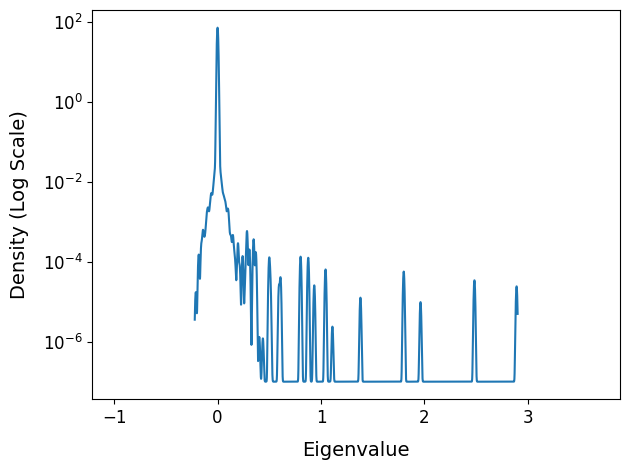

In [14]:
from density_plot import density_generate

# density_eigen, density_weight = hessian_comp.density()

density, grids = density_generate(density_eigen, density_weight)
fig, ax = plt.subplots()  # Force creation of a new figure
ax.semilogy(grids, density + 1.0e-7)
ax.set_ylabel('Density (Log Scale)', fontsize=14, labelpad=10)
ax.set_xlabel('Eigenvalue', fontsize=14, labelpad=10)
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='y', labelsize=12)
ax.axis([np.min(density_eigen) - 1, np.max(density_eigen) + 1, None, None])
plt.tight_layout()

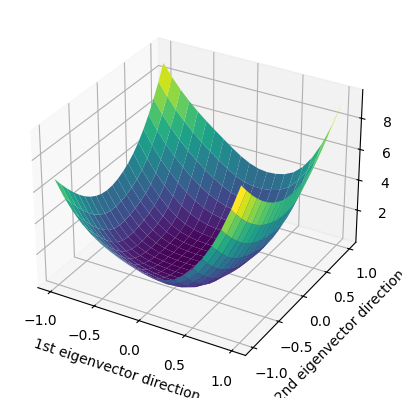

In [26]:
from pyhessian.hessian import hessian
# Assume model, loss_fn, and dataloader are defined

# 1. Compute the Hessian
inputs, targets = next(iter(test_loader))
loss = criterion(model(inputs), targets)
hessian_comp = hessian(model, criterion, data=(inputs, targets), cuda=False)

# 2. Get top 2 eigenvectors
top_eigenvalues, top_eigenvectors = hessian_comp.eigenvalues(top_n=2)
dir1 = top_eigenvectors[0]  # list of tensors, one per param
dir2 = top_eigenvectors[1]

# 3. Save original parameters
orig_params = [p.clone().detach() for p in model.parameters() if p.requires_grad]

# 4. Generate grid of alpha and beta
alphas = np.linspace(-1, 1, 21)
betas = np.linspace(-1, 1, 21)
loss_surface = np.zeros((len(alphas), len(betas)))

# 5. Evaluate loss over grid
for i, alpha in enumerate(alphas):
    for j, beta in enumerate(betas):
        # Perturb model parameters
        with torch.no_grad():
            for p, orig, d1, d2 in zip(model.parameters(), orig_params, dir1, dir2):
                p.data = orig + alpha * d1 + beta * d2

        # Compute loss
        outputs = model(inputs)
        loss_surface[i, j] = criterion(outputs, targets).item()

# Reset model parameters
with torch.no_grad():
    for p, orig in zip(model.parameters(), orig_params):
        p.data = orig.clone()

# 6. Plot the surface
X, Y = np.meshgrid(alphas, betas)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, loss_surface, cmap='viridis')
ax.set_xlabel("1st eigenvector direction")
ax.set_ylabel("2nd eigenvector direction")
ax.set_zlabel("Loss")
plt.show()


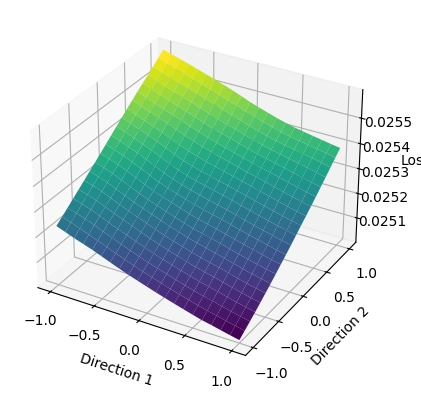

In [18]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assume 'model' is your trained PyTorch model
# 'loss_fn' is your loss function
# 'data_loader' provides input data and labels

# Step 1: Get current model parameters
params = [p.clone().detach() for p in model.parameters() if p.requires_grad]

# Step 2: Generate random direction vectors
def generate_direction(params):
    return [torch.randn_like(p) for p in params]

dir1 = generate_direction(params)
dir2 = generate_direction(params)

# Normalize directions
def normalize_direction(direction):
    norm = torch.sqrt(sum(torch.sum(d**2) for d in direction))
    return [d / norm for d in direction]

dir1 = normalize_direction(dir1)
dir2 = normalize_direction(dir2)

# Step 3: Compute loss over a grid
alphas = np.linspace(-1, 1, 21)
betas = np.linspace(-1, 1, 21)
loss_surface = np.zeros((len(alphas), len(betas)))

for i, alpha in enumerate(alphas):
    for j, beta in enumerate(betas):
        # Perturb parameters
        for p, d1, d2 in zip(model.parameters(), dir1, dir2):
            p.data = p.data + alpha * d1 + beta * d2

        # Compute loss
        inputs, targets = next(iter(test_loader))
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        loss_surface[i, j] = loss.item()

        # Reset parameters
        for p, orig in zip(model.parameters(), params):
            p.data = orig.data.clone()

# Step 4: Plot the surface
X, Y = np.meshgrid(alphas, betas)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, loss_surface, cmap='viridis')
ax.set_xlabel('Direction 1')
ax.set_ylabel('Direction 2')
ax.set_zlabel('Loss')
plt.show()
